In [1]:
import os
os.chdir('mmpose')

In [ ]:
!python tools/misc/publish_model.py \
        work_dirs/rtmpose-s-Dog_hip_center/epoch_100.pth \
        checkpoint/epoch_100.pth

In [ ]:
!python tools/misc/publish_model.py \
        work_dirs/rtmpose-s-Dog_hip_head/epoch_90.pth \
        checkpoint/epoch_90.pth

In [2]:
import cv2
import numpy as np
from PIL import Image

import matplotlib.pyplot as plt
%matplotlib inline

import torch

import mmcv
from mmcv import imread
import mmengine
from mmengine.registry import init_default_scope

from mmpose.apis import inference_topdown
from mmpose.apis import init_model as init_pose_estimator
from mmpose.evaluation.functional import nms
from mmpose.registry import VISUALIZERS
from mmpose.structures import merge_data_samples
import matplotlib.patches as patches

from mmdet.apis import inference_detector, init_detector



In [4]:
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
print('device', device)

device cuda:0


In [7]:
# Faster R CNN 
detector = init_detector(
    '/home/featurize/work/mmdetection/data/faster_r_cnn_dog_hip_center.py',
    
    '/home/featurize/work/mmdetection/checkpoint/faster_r_cnn_dog_hip_center-c57daa93.pth',
    device=device
)

Loads checkpoint by local backend from path: /home/featurize/work/mmdetection/checkpoint/faster_r_cnn_dog_hip_center-c57daa93.pth


In [ ]:
# RTMDet 三角板检测
#detector = init_detector(
#    'data/rtmdet_tiny_triangle.py',
#    'checkpoint/rtmdet_tiny_triangle_epoch_200_202305120847-3cd02a8f.pth',
#    device=device
#)

In [ ]:
pose_estimator = init_pose_estimator(
    '/home/featurize/work/mmpose/data/rtmpose-s-Dog_hip_center.py',
    '/home/featurize/work/mmpose/checkpoint/epoch_100-6715b883_20240714.pth',
    device=device,
    cfg_options={'model': {'test_cfg': {'output_heatmaps': False}}}
)

Loads checkpoint by local backend from path: /home/featurize/work/mmpose/checkpoint/epoch_100-6715b883_20240714.pth


Processing /home/featurize/work/data/data/Valid/images/162647.jpg
pose_results: [<PoseDataSample(

    META INFORMATION
    img_shape: (768, 1908)
    flip_indices: [0]
    img_path: '/home/featurize/work/data/data/Valid/images/162647.jpg'
    ori_shape: (768, 1908)
    input_size: (256, 256)

    DATA FIELDS
    gt_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_centers: array([[744. , 401.5]])
            bbox_scores: array([1.], dtype=float32)
            bboxes: array([[673, 338, 815, 465]])
            bbox_scales: array([[177.5, 177.5]])
        ) at 0x7fab8c543c10>
    gt_instance_labels: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
        ) at 0x7fab8c4ea150>
    pred_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_scores: array([1.], dtype=float32)
            bboxes: array([[673, 338, 815, 465]])
        

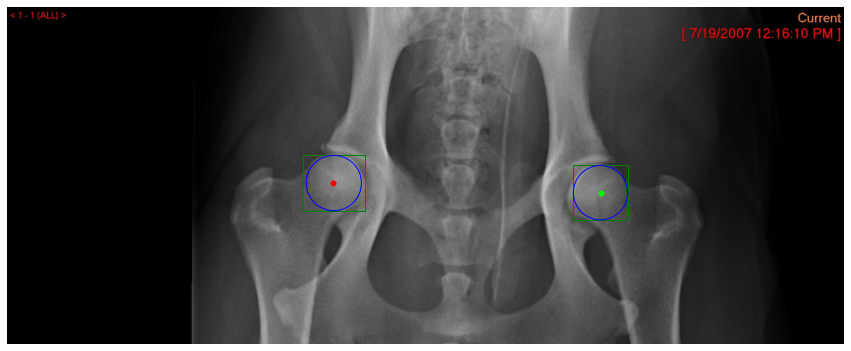

Processing /home/featurize/work/data/data/Valid/images/199118.jpg
pose_results: [<PoseDataSample(

    META INFORMATION
    img_shape: (768, 1908)
    flip_indices: [0]
    img_path: '/home/featurize/work/data/data/Valid/images/199118.jpg'
    ori_shape: (768, 1908)
    input_size: (256, 256)

    DATA FIELDS
    gt_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_centers: array([[662. , 347.5]])
            bbox_scores: array([1.], dtype=float32)
            bboxes: array([[589, 274, 735, 421]])
            bbox_scales: array([[183.75, 183.75]])
        ) at 0x7fab8a167110>
    gt_instance_labels: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
        ) at 0x7fab8a1673d0>
    pred_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_scores: array([1.], dtype=float32)
            bboxes: array([[589, 274, 735, 421]])
      

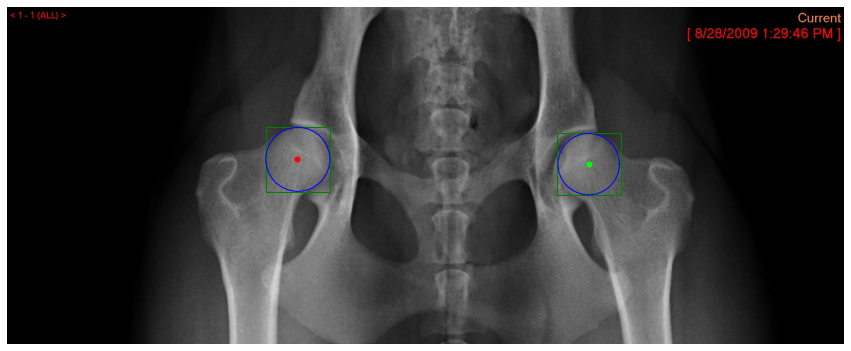

Processing /home/featurize/work/data/data/Valid/images/177494.jpg
pose_results: [<PoseDataSample(

    META INFORMATION
    img_shape: (768, 1908)
    flip_indices: [0]
    img_path: '/home/featurize/work/data/data/Valid/images/177494.jpg'
    ori_shape: (768, 1908)
    input_size: (256, 256)

    DATA FIELDS
    gt_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_centers: array([[1316.,  405.]])
            bbox_scores: array([1.], dtype=float32)
            bboxes: array([[1256,  354, 1376,  456]])
            bbox_scales: array([[150., 150.]])
        ) at 0x7fab8a167ad0>
    gt_instance_labels: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
        ) at 0x7fab8a167fd0>
    pred_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_scores: array([1.], dtype=float32)
            bboxes: array([[1256,  354, 1376,  456]])
  

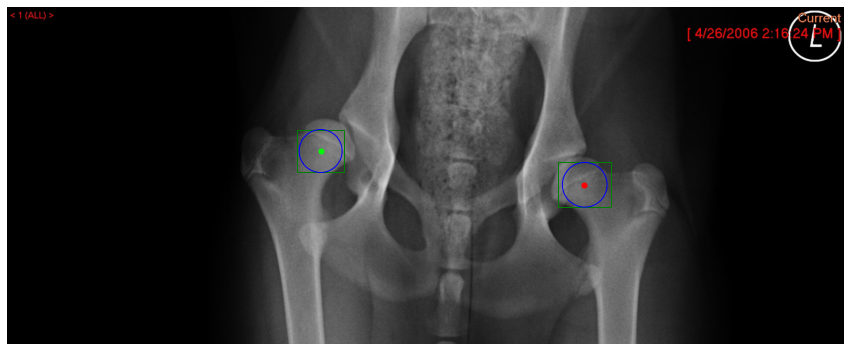

Processing /home/featurize/work/data/data/Valid/images/182979.jpg
Processing /home/featurize/work/data/data/Valid/images/208621.jpg
Processing /home/featurize/work/data/data/Valid/images/172203.jpg
Processing /home/featurize/work/data/data/Valid/images/165569.jpg
pose_results: [<PoseDataSample(

    META INFORMATION
    img_shape: (768, 1908)
    flip_indices: [0]
    img_path: '/home/featurize/work/data/data/Valid/images/165569.jpg'
    ori_shape: (768, 1908)
    input_size: (256, 256)

    DATA FIELDS
    gt_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_centers: array([[1297. ,  363.5]])
            bbox_scores: array([1.], dtype=float32)
            bboxes: array([[1244,  313, 1350,  414]])
            bbox_scales: array([[132.5, 132.5]])
        ) at 0x7fab8b9ba990>
    gt_instance_labels: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
        ) at 0x7fab8b7ec810>
    pred_ins

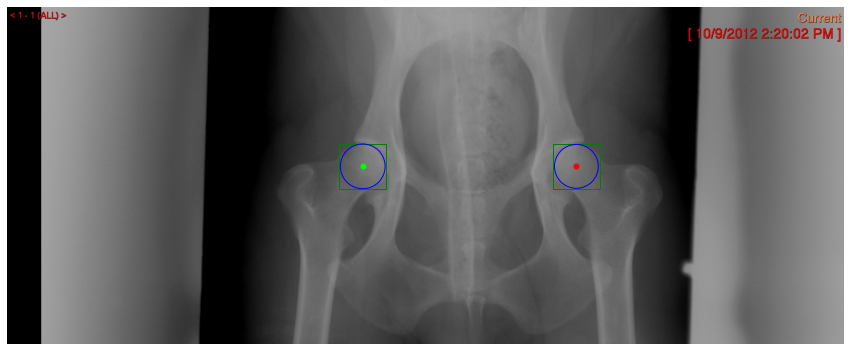

Processing /home/featurize/work/data/data/Valid/images/173119.jpg
pose_results: [<PoseDataSample(

    META INFORMATION
    img_shape: (2504, 2048)
    flip_indices: [0]
    img_path: '/home/featurize/work/data/data/Valid/images/173119.jpg'
    ori_shape: (2504, 2048)
    input_size: (256, 256)

    DATA FIELDS
    gt_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_centers: array([[806. , 471.5]])
            bbox_scores: array([1.], dtype=float32)
            bboxes: array([[738, 405, 874, 538]])
            bbox_scales: array([[170., 170.]])
        ) at 0x7fab8b6c1890>
    gt_instance_labels: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
        ) at 0x7fab8b890750>
    pred_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_scores: array([1.], dtype=float32)
            bboxes: array([[738, 405, 874, 538]])
        

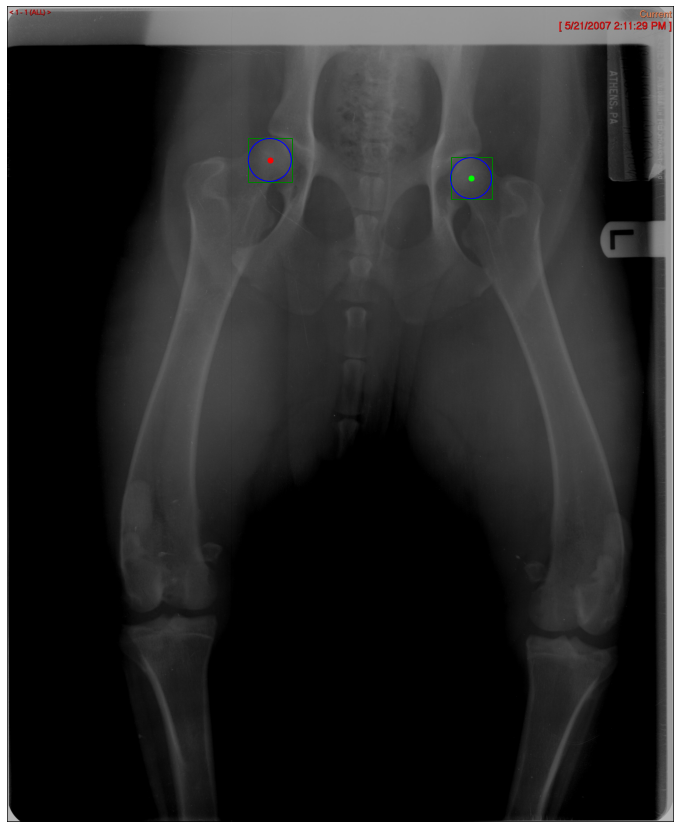

Processing /home/featurize/work/data/data/Valid/images/191789.jpg
pose_results: [<PoseDataSample(

    META INFORMATION
    img_shape: (2500, 2048)
    flip_indices: [0]
    img_path: '/home/featurize/work/data/data/Valid/images/191789.jpg'
    ori_shape: (2500, 2048)
    input_size: (256, 256)

    DATA FIELDS
    gt_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_centers: array([[590., 725.]])
            bbox_scores: array([1.], dtype=float32)
            bboxes: array([[518, 654, 662, 796]])
            bbox_scales: array([[180., 180.]])
        ) at 0x7fab8b770990>
    gt_instance_labels: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
        ) at 0x7fab8b770390>
    pred_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_scores: array([1.], dtype=float32)
            bboxes: array([[518, 654, 662, 796]])
          

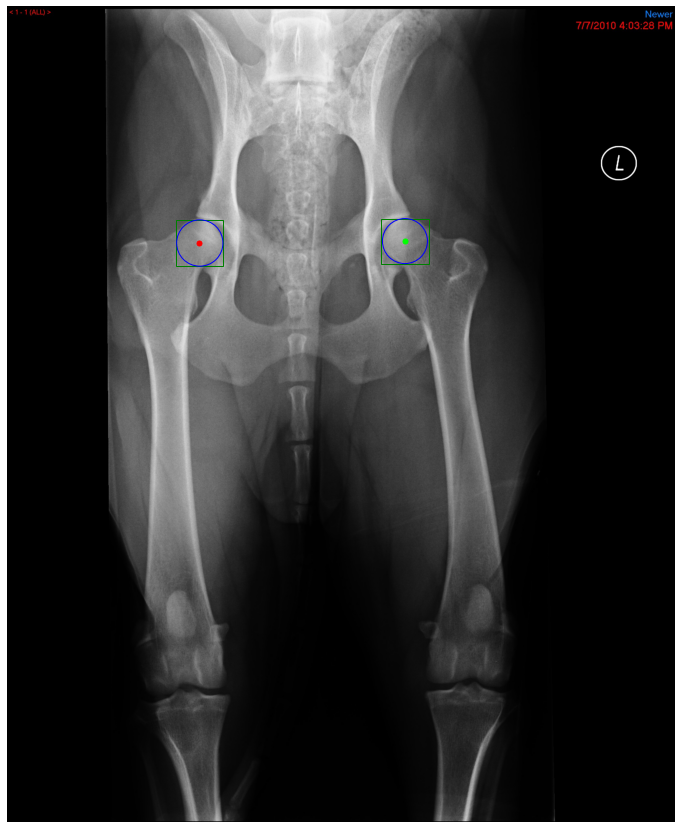

Processing /home/featurize/work/data/data/Valid/images/195849.jpg
pose_results: [<PoseDataSample(

    META INFORMATION
    img_shape: (768, 1908)
    flip_indices: [0]
    img_path: '/home/featurize/work/data/data/Valid/images/195849.jpg'
    ori_shape: (768, 1908)
    input_size: (256, 256)

    DATA FIELDS
    gt_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_centers: array([[621., 291.]])
            bbox_scores: array([1.], dtype=float32)
            bboxes: array([[560, 229, 682, 353]])
            bbox_scales: array([[155., 155.]])
        ) at 0x7fab8bbc3050>
    gt_instance_labels: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
        ) at 0x7fab8bbc3290>
    pred_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_scores: array([1.], dtype=float32)
            bboxes: array([[560, 229, 682, 353]])
            

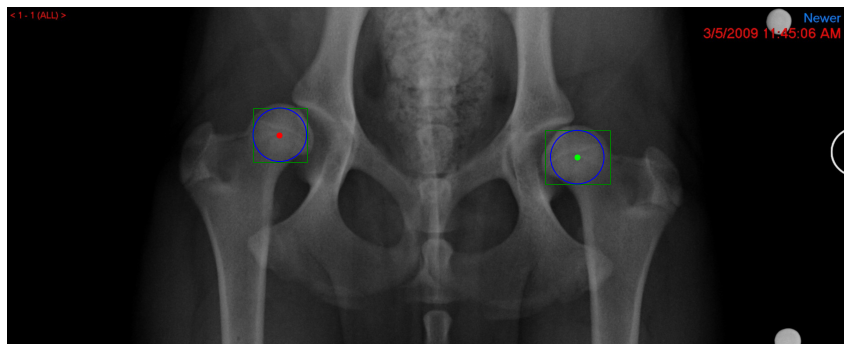

Processing /home/featurize/work/data/data/Valid/images/207341.jpg
Processing /home/featurize/work/data/data/Valid/images/194495.jpg
pose_results: [<PoseDataSample(

    META INFORMATION
    img_shape: (768, 1908)
    flip_indices: [0]
    img_path: '/home/featurize/work/data/data/Valid/images/194495.jpg'
    ori_shape: (768, 1908)
    input_size: (256, 256)

    DATA FIELDS
    gt_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_centers: array([[1394.5,  363. ]])
            bbox_scores: array([1.], dtype=float32)
            bboxes: array([[1333,  312, 1456,  414]])
            bbox_scales: array([[153.75, 153.75]])
        ) at 0x7fab8b719a90>
    gt_instance_labels: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
        ) at 0x7fab8b719890>
    pred_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_scores: array([1.],

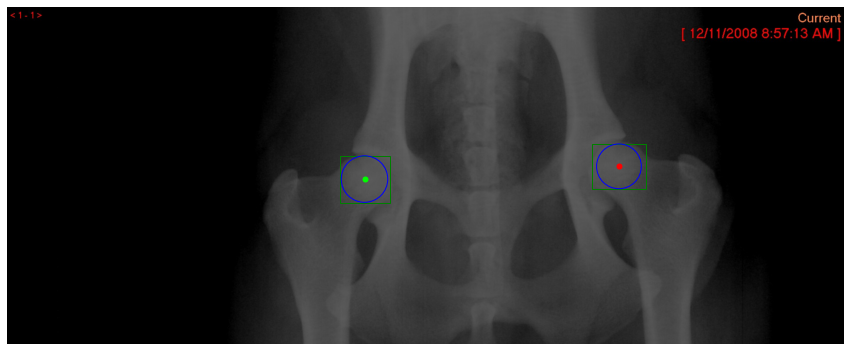

Processing /home/featurize/work/data/data/Valid/images/194955.jpg
Processing /home/featurize/work/data/data/Valid/images/208763.jpg
pose_results: [<PoseDataSample(

    META INFORMATION
    img_shape: (768, 1908)
    flip_indices: [0]
    img_path: '/home/featurize/work/data/data/Valid/images/208763.jpg'
    ori_shape: (768, 1908)
    input_size: (256, 256)

    DATA FIELDS
    gt_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_centers: array([[686., 333.]])
            bbox_scores: array([1.], dtype=float32)
            bboxes: array([[618, 263, 754, 403]])
            bbox_scales: array([[175., 175.]])
        ) at 0x7fab8b6717d0>
    gt_instance_labels: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
        ) at 0x7fab8b671750>
    pred_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_scores: array([1.], dtype=float

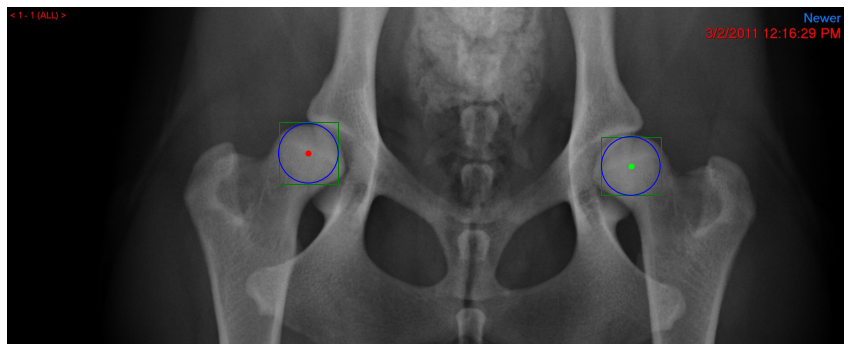

Processing /home/featurize/work/data/data/Valid/images/195827.jpg
pose_results: [<PoseDataSample(

    META INFORMATION
    img_shape: (768, 1908)
    flip_indices: [0]
    img_path: '/home/featurize/work/data/data/Valid/images/195827.jpg'
    ori_shape: (768, 1908)
    input_size: (256, 256)

    DATA FIELDS
    gt_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_centers: array([[578.5, 332. ]])
            bbox_scores: array([1.], dtype=float32)
            bboxes: array([[512, 274, 645, 390]])
            bbox_scales: array([[166.25, 166.25]])
        ) at 0x7facdfe11dd0>
    gt_instance_labels: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
        ) at 0x7facdfe11890>
    pred_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_scores: array([1.], dtype=float32)
            bboxes: array([[512, 274, 645, 390]])
      

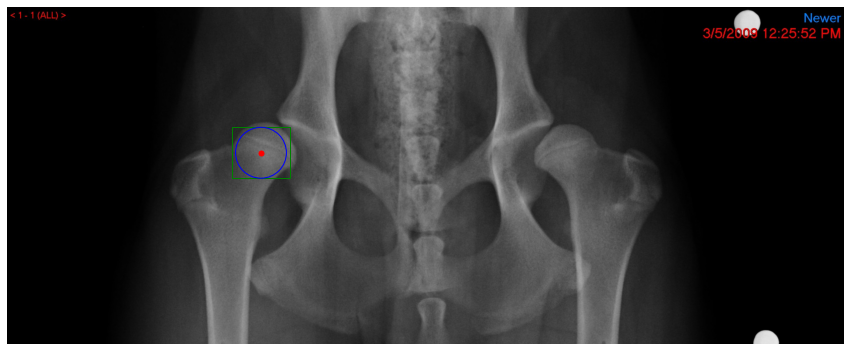

Processing /home/featurize/work/data/data/Valid/images/177424.jpg
Processing /home/featurize/work/data/data/Valid/images/161797.jpg
pose_results: [<PoseDataSample(

    META INFORMATION
    img_shape: (768, 1908)
    flip_indices: [0]
    img_path: '/home/featurize/work/data/data/Valid/images/161797.jpg'
    ori_shape: (768, 1908)
    input_size: (256, 256)

    DATA FIELDS
    gt_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_centers: array([[710.5, 329. ]])
            bbox_scores: array([1.], dtype=float32)
            bboxes: array([[658, 279, 763, 379]])
            bbox_scales: array([[131.25, 131.25]])
        ) at 0x7fab8b523090>
    gt_instance_labels: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
        ) at 0x7fab8b523150>
    pred_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_scores: array([1.], dtype

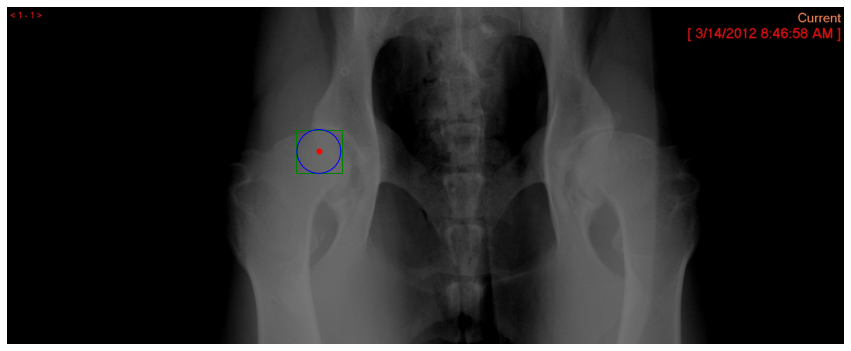

Processing /home/featurize/work/data/data/Valid/images/187156.jpg
Processing /home/featurize/work/data/data/Valid/images/192237.jpg
pose_results: [<PoseDataSample(

    META INFORMATION
    img_shape: (2500, 2048)
    flip_indices: [0]
    img_path: '/home/featurize/work/data/data/Valid/images/192237.jpg'
    ori_shape: (2500, 2048)
    input_size: (256, 256)

    DATA FIELDS
    gt_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_centers: array([[679.5, 534. ]])
            bbox_scores: array([1.], dtype=float32)
            bboxes: array([[600, 458, 759, 610]])
            bbox_scales: array([[198.75, 198.75]])
        ) at 0x7facdc56c090>
    gt_instance_labels: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
        ) at 0x7facdc56c890>
    pred_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_scores: array([1.], dty

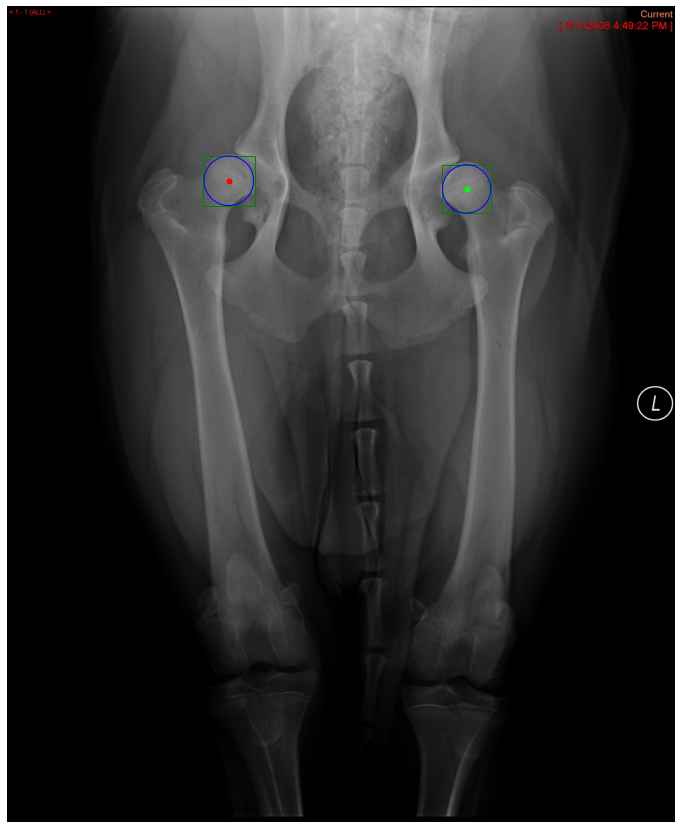

Processing /home/featurize/work/data/data/Valid/images/217378.jpg
pose_results: [<PoseDataSample(

    META INFORMATION
    img_shape: (4200, 3408)
    flip_indices: [0]
    img_path: '/home/featurize/work/data/data/Valid/images/217378.jpg'
    ori_shape: (4200, 3408)
    input_size: (256, 256)

    DATA FIELDS
    gt_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_centers: array([[1108. , 1423.5]])
            bbox_scores: array([1.], dtype=float32)
            bboxes: array([[ 982, 1302, 1234, 1545]])
            bbox_scales: array([[315., 315.]])
        ) at 0x7fab8b8f7ed0>
    gt_instance_labels: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
        ) at 0x7fab8b8f7dd0>
    pred_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_scores: array([1.], dtype=float32)
            bboxes: array([[ 982, 1302, 1234, 1545]]

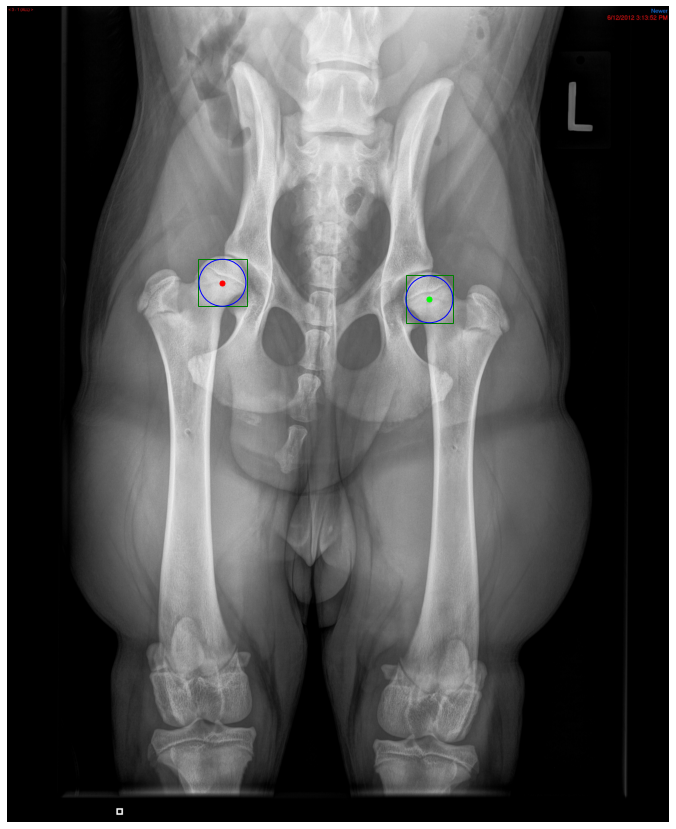

Processing /home/featurize/work/data/data/Valid/images/201697.jpg
Processing /home/featurize/work/data/data/Valid/images/201935.jpg
Processing /home/featurize/work/data/data/Valid/images/218026.jpg
pose_results: [<PoseDataSample(

    META INFORMATION
    img_shape: (4200, 3408)
    flip_indices: [0]
    img_path: '/home/featurize/work/data/data/Valid/images/218026.jpg'
    ori_shape: (4200, 3408)
    input_size: (256, 256)

    DATA FIELDS
    gt_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_centers: array([[2189.5, 1352. ]])
            bbox_scores: array([1.], dtype=float32)
            bboxes: array([[2082, 1247, 2297, 1457]])
            bbox_scales: array([[268.75, 268.75]])
        ) at 0x7fab8bacf890>
    gt_instance_labels: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
        ) at 0x7fab8bacfb90>
    pred_instances: <InstanceData(
        
            META INFORMATION
 

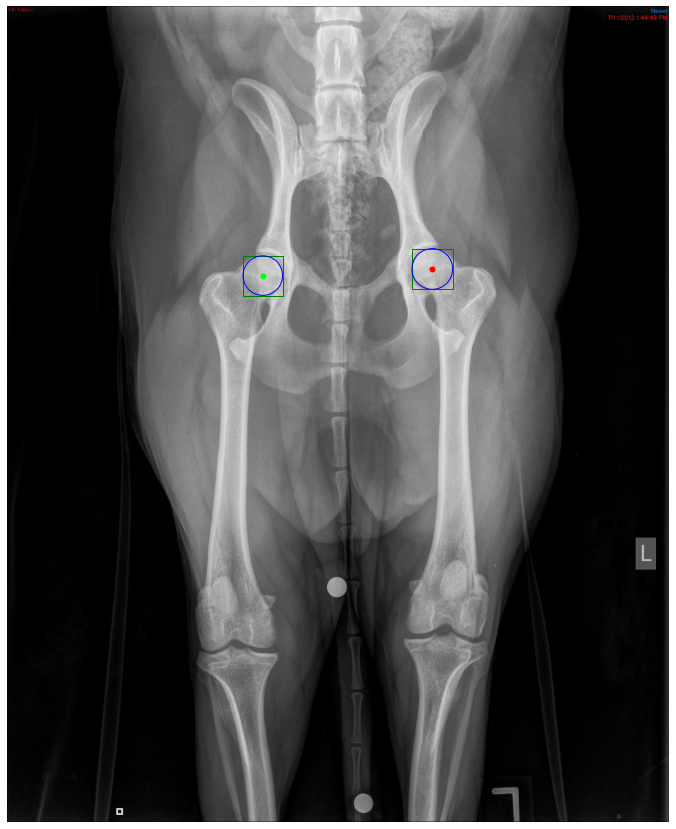

Processing /home/featurize/work/data/data/Valid/images/172118.jpg
pose_results: [<PoseDataSample(

    META INFORMATION
    img_shape: (768, 1908)
    flip_indices: [0]
    img_path: '/home/featurize/work/data/data/Valid/images/172118.jpg'
    ori_shape: (768, 1908)
    input_size: (256, 256)

    DATA FIELDS
    gt_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_centers: array([[776. , 412.5]])
            bbox_scores: array([1.], dtype=float32)
            bboxes: array([[727, 364, 825, 461]])
            bbox_scales: array([[122.5, 122.5]])
        ) at 0x7fab8b982a10>
    gt_instance_labels: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
        ) at 0x7fab8b545390>
    pred_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_scores: array([1.], dtype=float32)
            bboxes: array([[727, 364, 825, 461]])
        

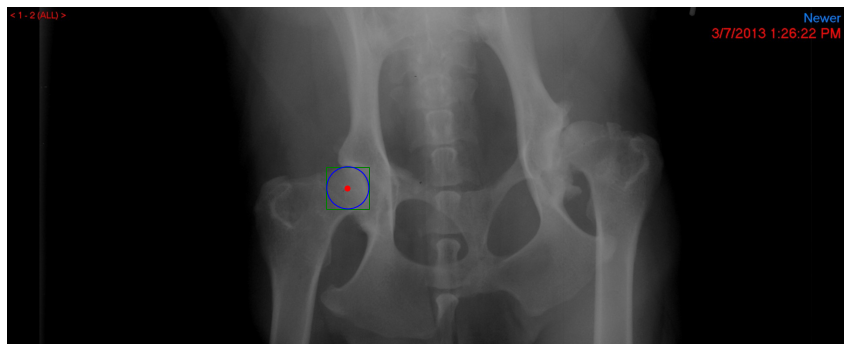

Processing /home/featurize/work/data/data/Valid/images/190237.jpg
pose_results: [<PoseDataSample(

    META INFORMATION
    img_shape: (768, 1908)
    flip_indices: [0]
    img_path: '/home/featurize/work/data/data/Valid/images/190237.jpg'
    ori_shape: (768, 1908)
    input_size: (256, 256)

    DATA FIELDS
    gt_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_centers: array([[1340.5,  359.5]])
            bbox_scores: array([1.], dtype=float32)
            bboxes: array([[1282,  302, 1399,  417]])
            bbox_scales: array([[146.25, 146.25]])
        ) at 0x7fab8b819d50>
    gt_instance_labels: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
        ) at 0x7fab8b819b90>
    pred_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_scores: array([1.], dtype=float32)
            bboxes: array([[1282,  302, 1399,  417

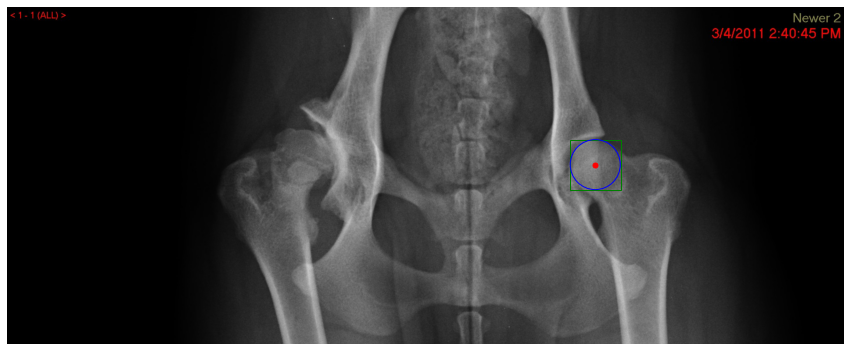

Processing /home/featurize/work/data/data/Valid/images/197232.jpg
pose_results: [<PoseDataSample(

    META INFORMATION
    img_shape: (768, 1908)
    flip_indices: [0]
    img_path: '/home/featurize/work/data/data/Valid/images/197232.jpg'
    ori_shape: (768, 1908)
    input_size: (256, 256)

    DATA FIELDS
    gt_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_centers: array([[591. , 346.5]])
            bbox_scores: array([1.], dtype=float32)
            bboxes: array([[513, 276, 669, 417]])
            bbox_scales: array([[195., 195.]])
        ) at 0x7fab8b819a90>
    gt_instance_labels: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
        ) at 0x7fab8b8190d0>
    pred_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_scores: array([1.], dtype=float32)
            bboxes: array([[513, 276, 669, 417]])
          

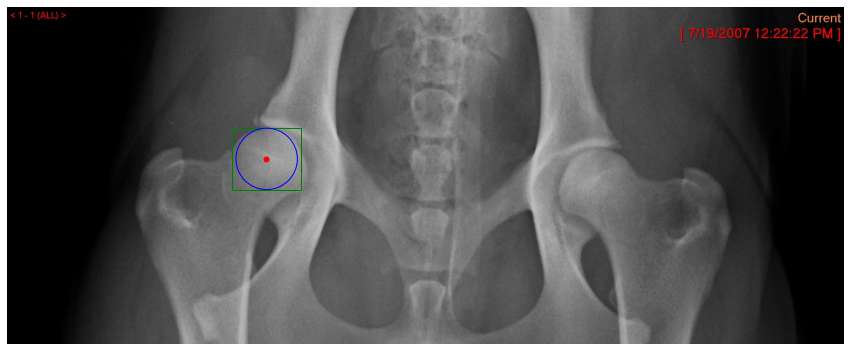

Processing /home/featurize/work/data/data/Valid/images/218690.jpg
pose_results: [<PoseDataSample(

    META INFORMATION
    img_shape: (756, 1908)
    flip_indices: [0]
    img_path: '/home/featurize/work/data/data/Valid/images/218690.jpg'
    ori_shape: (756, 1908)
    input_size: (256, 256)

    DATA FIELDS
    gt_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_centers: array([[696., 440.]])
            bbox_scores: array([1.], dtype=float32)
            bboxes: array([[629, 377, 763, 503]])
            bbox_scales: array([[167.5, 167.5]])
        ) at 0x7fab85fd1e50>
    gt_instance_labels: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
        ) at 0x7fab85fd1190>
    pred_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_scores: array([1.], dtype=float32)
            bboxes: array([[629, 377, 763, 503]])
          

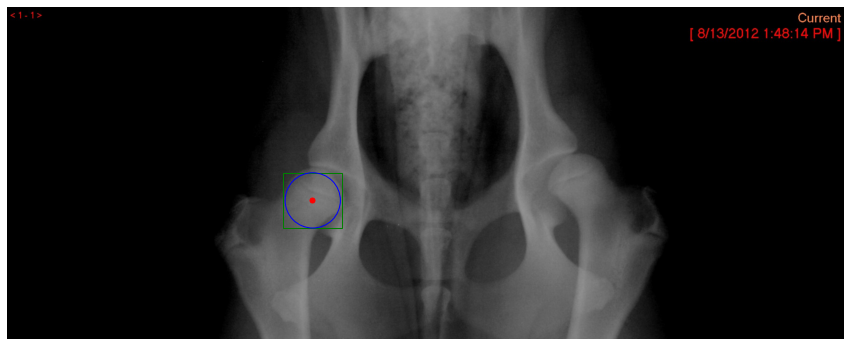

Processing /home/featurize/work/data/data/Valid/images/215195.jpg
Processing /home/featurize/work/data/data/Valid/images/184896.jpg
pose_results: [<PoseDataSample(

    META INFORMATION
    img_shape: (2500, 2048)
    flip_indices: [0]
    img_path: '/home/featurize/work/data/data/Valid/images/184896.jpg'
    ori_shape: (2500, 2048)
    input_size: (256, 256)

    DATA FIELDS
    gt_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_centers: array([[ 696.5, 1213.5]])
            bbox_scores: array([1.], dtype=float32)
            bboxes: array([[ 632, 1150,  761, 1277]])
            bbox_scales: array([[161.25, 161.25]])
        ) at 0x7fab85fd1a10>
    gt_instance_labels: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
        ) at 0x7fab85fd1950>
    pred_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_scores: array([1.

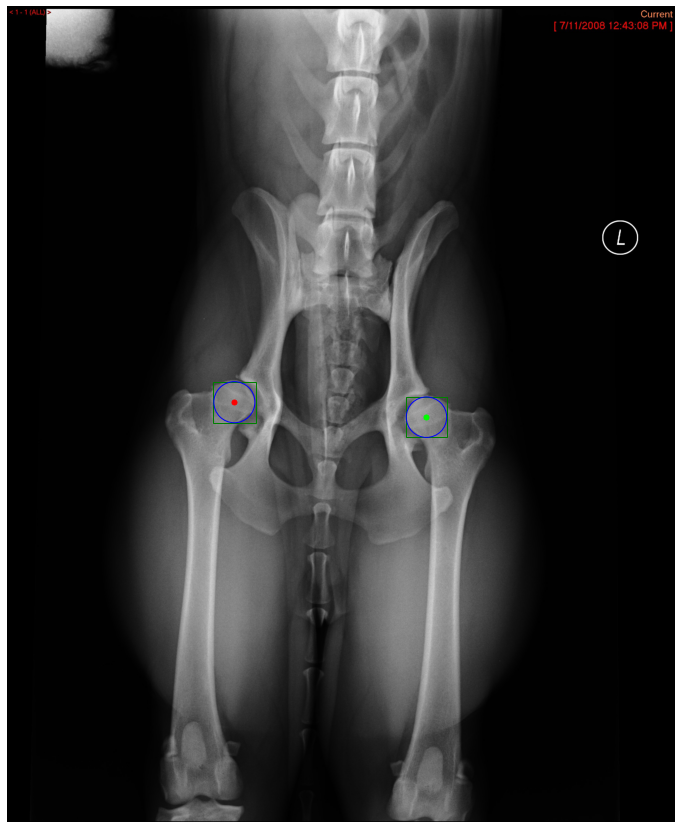

Processing /home/featurize/work/data/data/Valid/images/198301.jpg
pose_results: [<PoseDataSample(

    META INFORMATION
    img_shape: (768, 1908)
    flip_indices: [0]
    img_path: '/home/featurize/work/data/data/Valid/images/198301.jpg'
    ori_shape: (768, 1908)
    input_size: (256, 256)

    DATA FIELDS
    gt_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_centers: array([[741.5, 408. ]])
            bbox_scores: array([1.], dtype=float32)
            bboxes: array([[663, 347, 820, 469]])
            bbox_scales: array([[196.25, 196.25]])
        ) at 0x7fab85ed9650>
    gt_instance_labels: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
        ) at 0x7fab85ed9310>
    pred_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_scores: array([1.], dtype=float32)
            bboxes: array([[663, 347, 820, 469]])
      

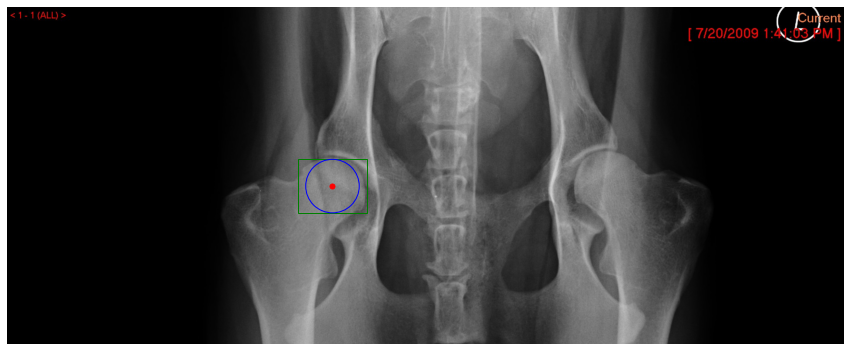

Processing /home/featurize/work/data/data/Valid/images/184956.jpg
pose_results: [<PoseDataSample(

    META INFORMATION
    img_shape: (768, 1908)
    flip_indices: [0]
    img_path: '/home/featurize/work/data/data/Valid/images/184956.jpg'
    ori_shape: (768, 1908)
    input_size: (256, 256)

    DATA FIELDS
    gt_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_centers: array([[753.5, 365.5]])
            bbox_scores: array([1.], dtype=float32)
            bboxes: array([[694, 308, 813, 423]])
            bbox_scales: array([[148.75, 148.75]])
        ) at 0x7fab8a02a510>
    gt_instance_labels: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
        ) at 0x7fab8a02af10>
    pred_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_scores: array([1.], dtype=float32)
            bboxes: array([[694, 308, 813, 423]])
      

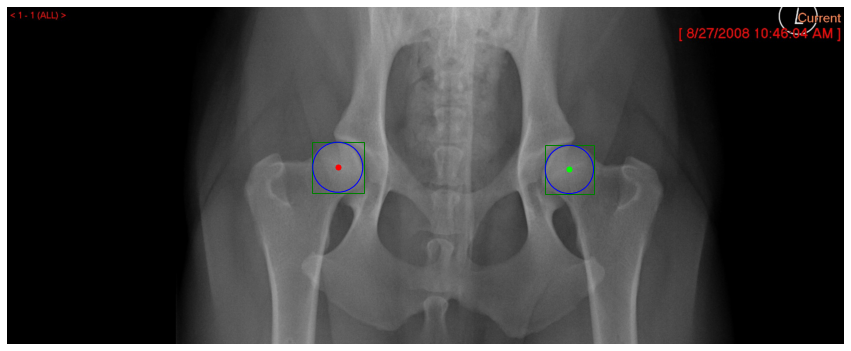

In [ ]:
img_dir = '/home/featurize/work/data/data/Valid/images'
image_files = [f for f in os.listdir(img_dir) if f.lower().endswith(('.jpg', '.jpeg', '.png'))]

colors = [
    (255, 0, 0),    # 红色
    (0, 255, 0),    # 绿色
    (0, 0, 255),    # 蓝色
    (255, 255, 0),  # 黄色
]

for image_file in image_files:
    image_path = os.path.join(img_dir, image_file)
    print(f'Processing {image_path}')
    image = imread(image_path)
    
    init_default_scope(detector.cfg.get('default_scope', 'mmdet'))
    detect_result = inference_detector(detector, image_path)
    
    CONF_THRES = 0.5

    pred_instance = detect_result.pred_instances.cpu().numpy()
    bboxes = np.concatenate((pred_instance.bboxes, pred_instance.scores[:, None]), axis=1)
    bboxes = bboxes[np.logical_and(pred_instance.labels == 0, pred_instance.scores > CONF_THRES)]
    bboxes = bboxes[nms(bboxes, 0.3)][:, :4].astype('int')
    
    if len(bboxes) > 0:
        pose_results = inference_topdown(pose_estimator, image_path, bboxes)
        
        # 检查 pose_results 的结构
        print(f'pose_results: {pose_results}')
        
        try:
            data_samples = merge_data_samples(pose_results)
            keypoints = data_samples.pred_instances.keypoints.astype('int')
            print(f'keypoints: {keypoints}')
        except ValueError as e:
            print(f'Error merging data samples: {e}')
            continue
        
        
        #####plot
        fig, ax = plt.subplots(figsize=(15, 15))  
        ax.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
        ax.set_aspect('equal', 'box')

        for idx, bbox in enumerate(bboxes):
            # 绘制边界框
            rect = patches.Rectangle((bbox[0], bbox[1]), bbox[2] - bbox[0], bbox[3] - bbox[1], linewidth=1, edgecolor='g', facecolor='none')
            ax.add_patch(rect)
            
            # 计算并绘制圆圈
            center_x = (bbox[0] + bbox[2]) // 2
            center_y = (bbox[1] + bbox[3]) // 2
            radius = min(bbox[2] - bbox[0], bbox[3] - bbox[1]) // 2
            circle = plt.Circle((center_x, center_y), radius, color='b', fill=False)
            ax.add_patch(circle)
            
            # 绘制关键点
            keypoint = keypoints[idx]
            for x, y in keypoint:
                color = colors[idx % len(colors)]  
                cv2.circle(image, (x, y), 5, color, -1)  
                ax.plot(x, y, 'o', color=np.array(color)/255.0, markersize=5)

        plt.axis('off')
        plt.show()

In [5]:
# Faster R CNN 
detector2 = init_detector(
    '/home/featurize/work/mmdetection/data/faster_r_cnn_dog_hip_head.py',
    
    '/home/featurize/work/mmdetection/checkpoint/faster_r_cnn_dog_hip_head-e523a27d.pth',
    device=device
)

Loads checkpoint by local backend from path: /home/featurize/work/mmdetection/checkpoint/faster_r_cnn_dog_hip_head-e523a27d.pth


In [6]:
pose_estimator2 = init_pose_estimator(
    '/home/featurize/work/mmpose/data/rtmpose-s-Dog_hip_head.py',
    '/home/featurize/work/mmpose/checkpoint/epoch_90-74c4f774_20240714.pth',
    device=device,
    cfg_options={'model': {'test_cfg': {'output_heatmaps': False}}}
)

Loads checkpoint by local backend from path: /home/featurize/work/mmpose/checkpoint/epoch_90-74c4f774_20240714.pth


Processing /home/featurize/work/data/data/Valid/images/162647.jpg
07/14 08:51:19 - mmengine - WARNING - The current default scope "mmpose" is not "mmdet", `init_default_scope` will force set the currentdefault scope to "mmdet".
07/14 08:51:19 - mmengine - WARNING - The current default scope "mmdet" is not "mmpose", `init_default_scope` will force set the currentdefault scope to "mmpose".
pose_results: [<PoseDataSample(

    META INFORMATION
    img_shape: (768, 1908)
    flip_indices: [0]
    img_path: '/home/featurize/work/data/data/Valid/images/162647.jpg'
    ori_shape: (768, 1908)
    input_size: (256, 256)

    DATA FIELDS
    gt_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_centers: array([[1377.,  354.]])
            bbox_scores: array([1.], dtype=float32)
            bboxes: array([[1326,  296, 1428,  412]])
            bbox_scales: array([[145., 145.]])
        ) at 0x7fab8c4eaa50>
    gt_instance_labels: <Ins

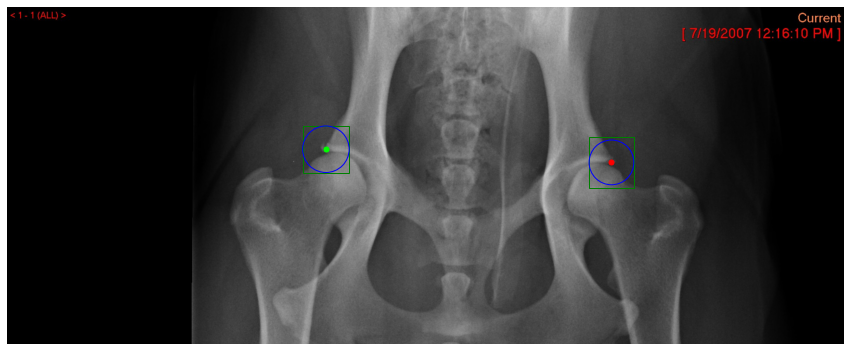

Processing /home/featurize/work/data/data/Valid/images/199118.jpg
pose_results: [<PoseDataSample(

    META INFORMATION
    img_shape: (768, 1908)
    flip_indices: [0]
    img_path: '/home/featurize/work/data/data/Valid/images/199118.jpg'
    ori_shape: (768, 1908)
    input_size: (256, 256)

    DATA FIELDS
    gt_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_centers: array([[1343. ,  280.5]])
            bbox_scores: array([1.], dtype=float32)
            bboxes: array([[1292,  231, 1394,  330]])
            bbox_scales: array([[127.5, 127.5]])
        ) at 0x7fab8bb85f90>
    gt_instance_labels: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
        ) at 0x7fab8bb857d0>
    pred_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_scores: array([1.], dtype=float32)
            bboxes: array([[1292,  231, 1394,  330]]

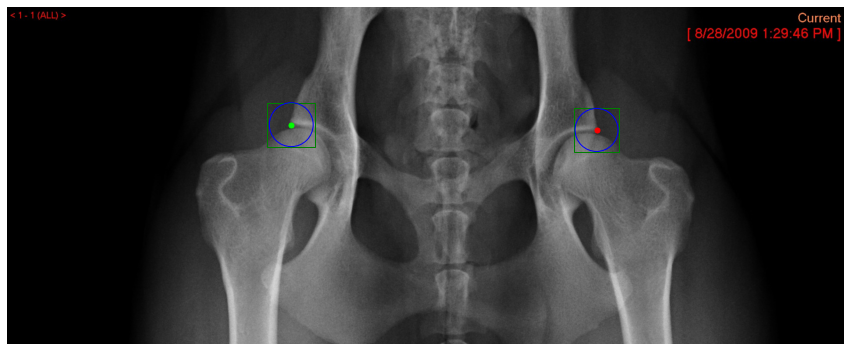

Processing /home/featurize/work/data/data/Valid/images/177494.jpg
pose_results: [<PoseDataSample(

    META INFORMATION
    img_shape: (768, 1908)
    flip_indices: [0]
    img_path: '/home/featurize/work/data/data/Valid/images/177494.jpg'
    ori_shape: (768, 1908)
    input_size: (256, 256)

    DATA FIELDS
    gt_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_centers: array([[757.5, 250. ]])
            bbox_scores: array([1.], dtype=float32)
            bboxes: array([[712, 208, 803, 292]])
            bbox_scales: array([[113.75, 113.75]])
        ) at 0x7fab8ba8df90>
    gt_instance_labels: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
        ) at 0x7fab8ba8d250>
    pred_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_scores: array([1.], dtype=float32)
            bboxes: array([[712, 208, 803, 292]])
      

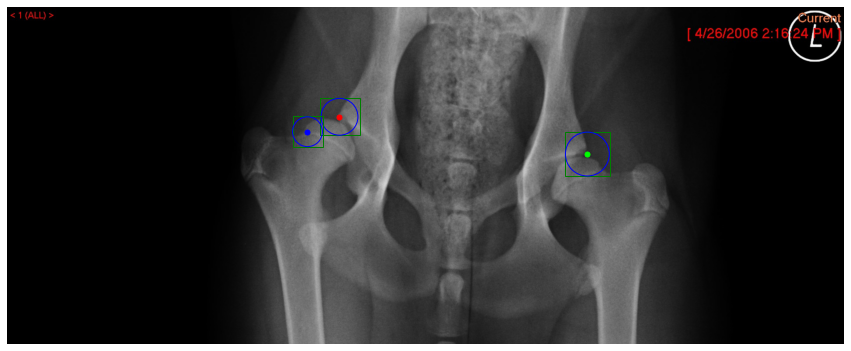

Processing /home/featurize/work/data/data/Valid/images/182979.jpg
pose_results: [<PoseDataSample(

    META INFORMATION
    img_shape: (768, 1908)
    flip_indices: [0]
    img_path: '/home/featurize/work/data/data/Valid/images/182979.jpg'
    ori_shape: (768, 1908)
    input_size: (256, 256)

    DATA FIELDS
    gt_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_centers: array([[656. , 334.5]])
            bbox_scores: array([1.], dtype=float32)
            bboxes: array([[619, 299, 693, 370]])
            bbox_scales: array([[92.5, 92.5]])
        ) at 0x7fab8ba0e990>
    gt_instance_labels: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
        ) at 0x7fab8ba0ee10>
    pred_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_scores: array([1.], dtype=float32)
            bboxes: array([[619, 299, 693, 370]])
          

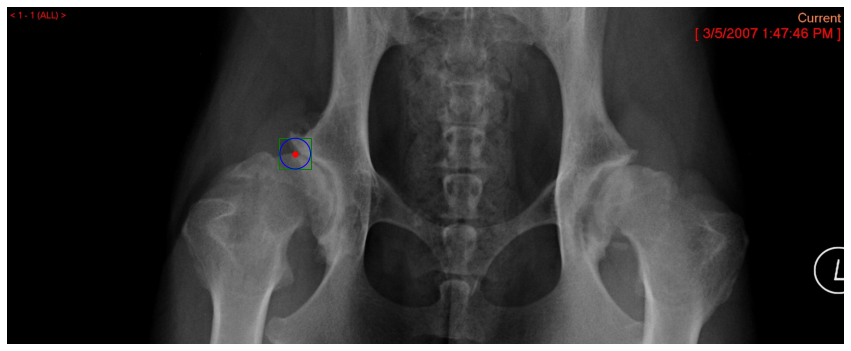

Processing /home/featurize/work/data/data/Valid/images/208621.jpg
pose_results: [<PoseDataSample(

    META INFORMATION
    img_shape: (756, 1908)
    flip_indices: [0]
    img_path: '/home/featurize/work/data/data/Valid/images/208621.jpg'
    ori_shape: (756, 1908)
    input_size: (256, 256)

    DATA FIELDS
    gt_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_centers: array([[612.5, 235.5]])
            bbox_scores: array([1.], dtype=float32)
            bboxes: array([[563, 186, 662, 285]])
            bbox_scales: array([[123.75, 123.75]])
        ) at 0x7fab8ba95310>
    gt_instance_labels: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
        ) at 0x7fab8b9fb750>
    pred_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_scores: array([1.], dtype=float32)
            bboxes: array([[563, 186, 662, 285]])
      

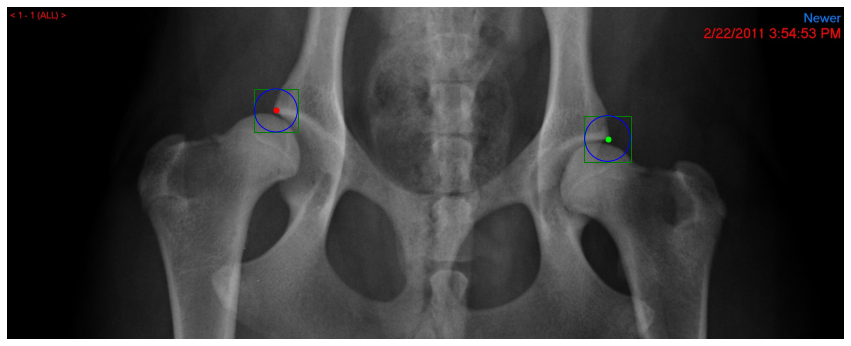

Processing /home/featurize/work/data/data/Valid/images/172203.jpg
Processing /home/featurize/work/data/data/Valid/images/165569.jpg
pose_results: [<PoseDataSample(

    META INFORMATION
    img_shape: (768, 1908)
    flip_indices: [0]
    img_path: '/home/featurize/work/data/data/Valid/images/165569.jpg'
    ori_shape: (768, 1908)
    input_size: (256, 256)

    DATA FIELDS
    gt_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_centers: array([[792.5, 306. ]])
            bbox_scores: array([1.], dtype=float32)
            bboxes: array([[743, 259, 842, 353]])
            bbox_scales: array([[123.75, 123.75]])
        ) at 0x7fab8b8a8610>
    gt_instance_labels: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
        ) at 0x7fab8b8a8c90>
    pred_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_scores: array([1.], dtype

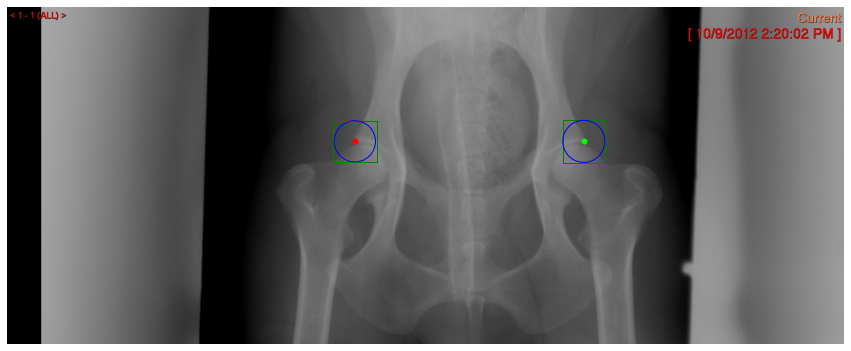

Processing /home/featurize/work/data/data/Valid/images/173119.jpg
pose_results: [<PoseDataSample(

    META INFORMATION
    img_shape: (2504, 2048)
    flip_indices: [0]
    img_path: '/home/featurize/work/data/data/Valid/images/173119.jpg'
    ori_shape: (2504, 2048)
    input_size: (256, 256)

    DATA FIELDS
    gt_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_centers: array([[802.5, 392. ]])
            bbox_scores: array([1.], dtype=float32)
            bboxes: array([[735, 326, 870, 458]])
            bbox_scales: array([[168.75, 168.75]])
        ) at 0x7fab8b898190>
    gt_instance_labels: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
        ) at 0x7fab8b898a50>
    pred_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_scores: array([1.], dtype=float32)
            bboxes: array([[735, 326, 870, 458]])
    

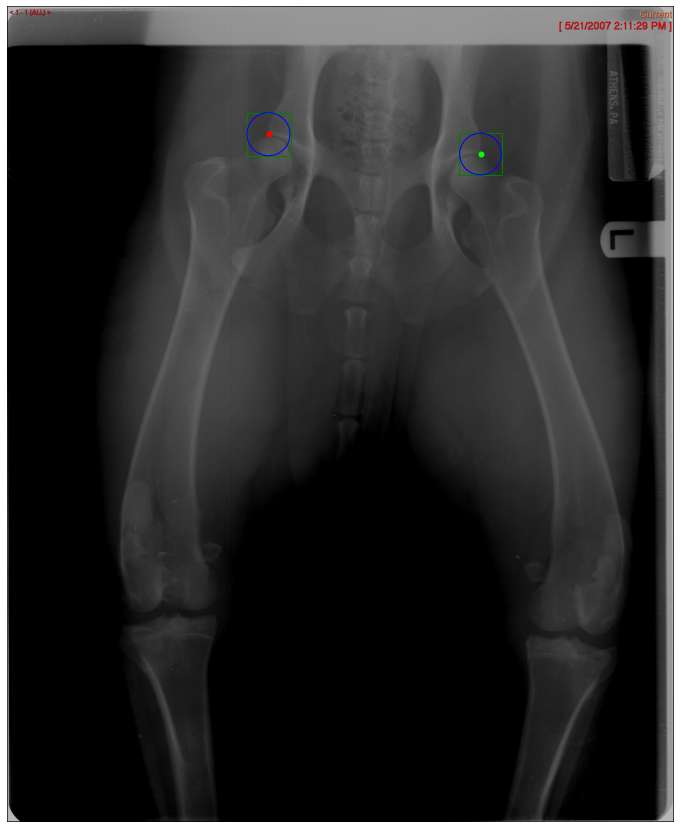

Processing /home/featurize/work/data/data/Valid/images/191789.jpg
pose_results: [<PoseDataSample(

    META INFORMATION
    img_shape: (2500, 2048)
    flip_indices: [0]
    img_path: '/home/featurize/work/data/data/Valid/images/191789.jpg'
    ori_shape: (2500, 2048)
    input_size: (256, 256)

    DATA FIELDS
    gt_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_centers: array([[1230.,  637.]])
            bbox_scores: array([1.], dtype=float32)
            bboxes: array([[1165,  573, 1295,  701]])
            bbox_scales: array([[162.5, 162.5]])
        ) at 0x7fab8b7d0850>
    gt_instance_labels: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
        ) at 0x7fab8b7d0b10>
    pred_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_scores: array([1.], dtype=float32)
            bboxes: array([[1165,  573, 1295,  701]]

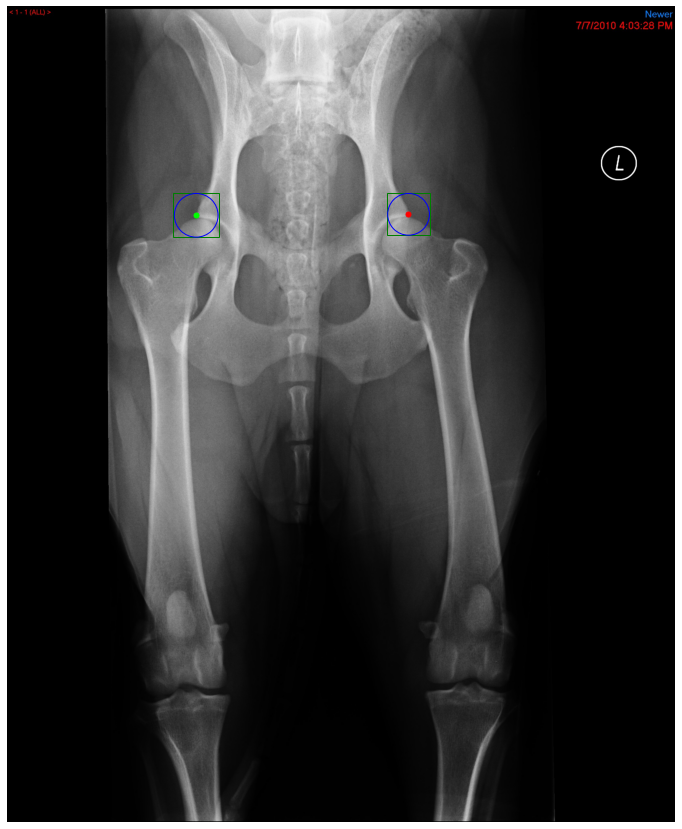

Processing /home/featurize/work/data/data/Valid/images/195849.jpg
pose_results: [<PoseDataSample(

    META INFORMATION
    img_shape: (768, 1908)
    flip_indices: [0]
    img_path: '/home/featurize/work/data/data/Valid/images/195849.jpg'
    ori_shape: (768, 1908)
    input_size: (256, 256)

    DATA FIELDS
    gt_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_centers: array([[1287. ,  259.5]])
            bbox_scores: array([1.], dtype=float32)
            bboxes: array([[1236,  209, 1338,  310]])
            bbox_scales: array([[127.5, 127.5]])
        ) at 0x7fab8b7d8b90>
    gt_instance_labels: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
        ) at 0x7fab8b7d8750>
    pred_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_scores: array([1.], dtype=float32)
            bboxes: array([[1236,  209, 1338,  310]]

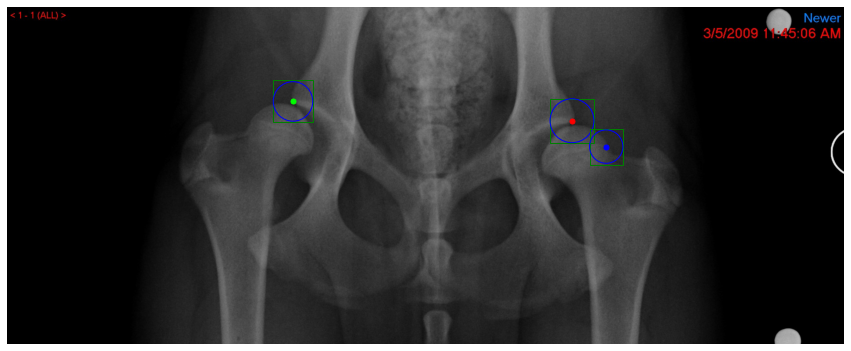

Processing /home/featurize/work/data/data/Valid/images/207341.jpg
pose_results: [<PoseDataSample(

    META INFORMATION
    img_shape: (768, 1908)
    flip_indices: [0]
    img_path: '/home/featurize/work/data/data/Valid/images/207341.jpg'
    ori_shape: (768, 1908)
    input_size: (256, 256)

    DATA FIELDS
    gt_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_centers: array([[1298.,  258.]])
            bbox_scores: array([1.], dtype=float32)
            bboxes: array([[1249,  207, 1347,  309]])
            bbox_scales: array([[127.5, 127.5]])
        ) at 0x7fab8b6ddfd0>
    gt_instance_labels: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
        ) at 0x7fab8b6ca150>
    pred_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_scores: array([1.], dtype=float32)
            bboxes: array([[1249,  207, 1347,  309]])


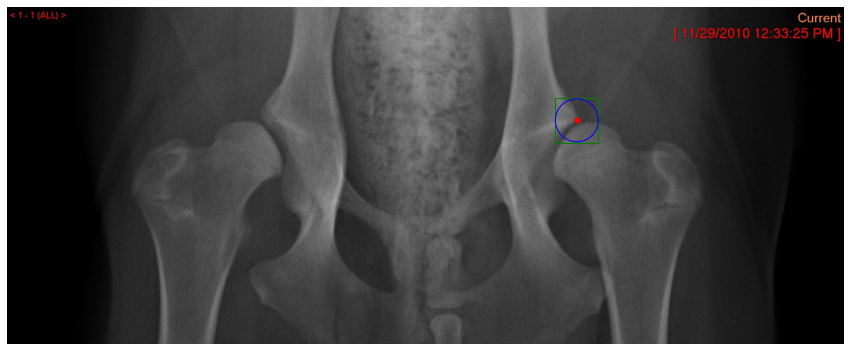

Processing /home/featurize/work/data/data/Valid/images/194495.jpg
pose_results: [<PoseDataSample(

    META INFORMATION
    img_shape: (768, 1908)
    flip_indices: [0]
    img_path: '/home/featurize/work/data/data/Valid/images/194495.jpg'
    ori_shape: (768, 1908)
    input_size: (256, 256)

    DATA FIELDS
    gt_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_centers: array([[787.5, 332. ]])
            bbox_scores: array([1.], dtype=float32)
            bboxes: array([[739, 286, 836, 378]])
            bbox_scales: array([[121.25, 121.25]])
        ) at 0x7fab8b5fc210>
    gt_instance_labels: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
        ) at 0x7fab8b5fcd90>
    pred_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_scores: array([1.], dtype=float32)
            bboxes: array([[739, 286, 836, 378]])
      

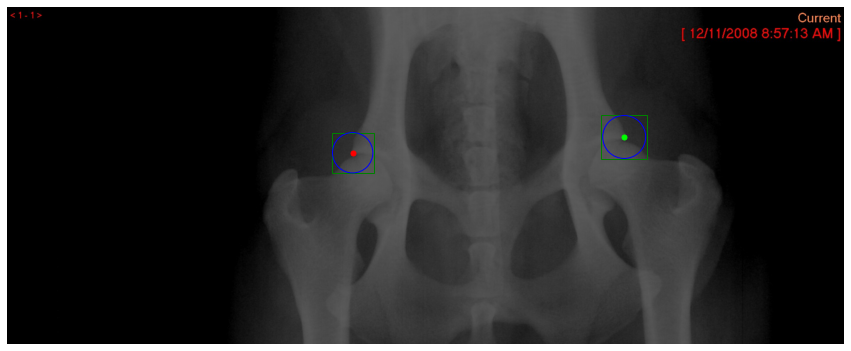

Processing /home/featurize/work/data/data/Valid/images/194955.jpg
pose_results: [<PoseDataSample(

    META INFORMATION
    img_shape: (768, 1908)
    flip_indices: [0]
    img_path: '/home/featurize/work/data/data/Valid/images/194955.jpg'
    ori_shape: (768, 1908)
    input_size: (256, 256)

    DATA FIELDS
    gt_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_centers: array([[1459. ,  343.5]])
            bbox_scores: array([1.], dtype=float32)
            bboxes: array([[1410,  294, 1508,  393]])
            bbox_scales: array([[123.75, 123.75]])
        ) at 0x7fab8b57eb50>
    gt_instance_labels: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
        ) at 0x7fab8b653510>
    pred_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_scores: array([1.], dtype=float32)
            bboxes: array([[1410,  294, 1508,  393

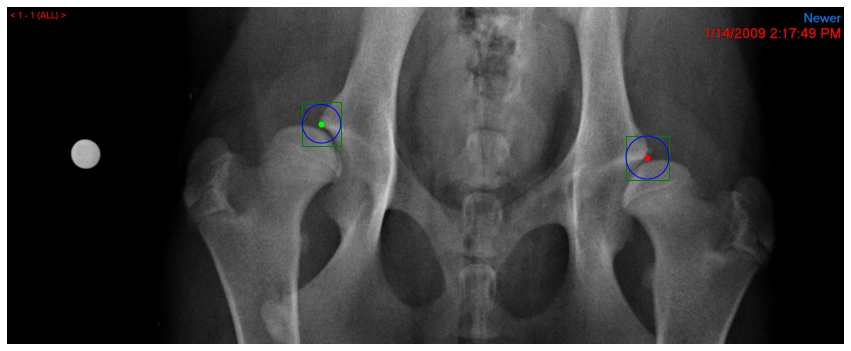

Processing /home/featurize/work/data/data/Valid/images/208763.jpg
pose_results: [<PoseDataSample(

    META INFORMATION
    img_shape: (768, 1908)
    flip_indices: [0]
    img_path: '/home/featurize/work/data/data/Valid/images/208763.jpg'
    ori_shape: (768, 1908)
    input_size: (256, 256)

    DATA FIELDS
    gt_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_centers: array([[686.5, 258.5]])
            bbox_scores: array([1.], dtype=float32)
            bboxes: array([[634, 209, 739, 308]])
            bbox_scales: array([[131.25, 131.25]])
        ) at 0x7fab8b4f3c10>
    gt_instance_labels: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
        ) at 0x7fab8b4f31d0>
    pred_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_scores: array([1.], dtype=float32)
            bboxes: array([[634, 209, 739, 308]])
      

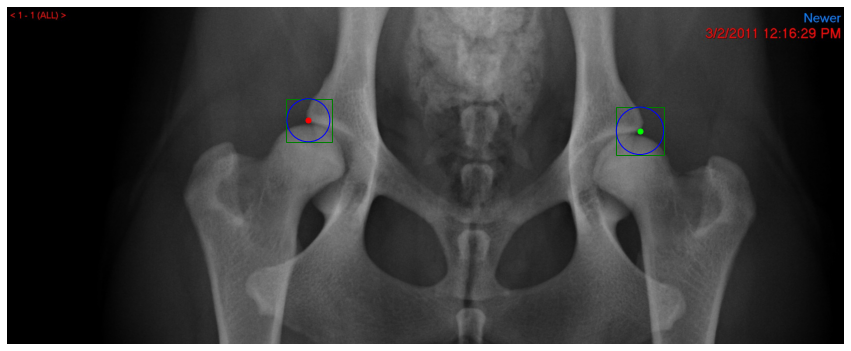

Processing /home/featurize/work/data/data/Valid/images/195827.jpg
pose_results: [<PoseDataSample(

    META INFORMATION
    img_shape: (768, 1908)
    flip_indices: [0]
    img_path: '/home/featurize/work/data/data/Valid/images/195827.jpg'
    ori_shape: (768, 1908)
    input_size: (256, 256)

    DATA FIELDS
    gt_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_centers: array([[616., 254.]])
            bbox_scores: array([1.], dtype=float32)
            bboxes: array([[569, 207, 663, 301]])
            bbox_scales: array([[117.5, 117.5]])
        ) at 0x7fab8b518a50>
    gt_instance_labels: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
        ) at 0x7fab8b518390>
    pred_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_scores: array([1.], dtype=float32)
            bboxes: array([[569, 207, 663, 301]])
          

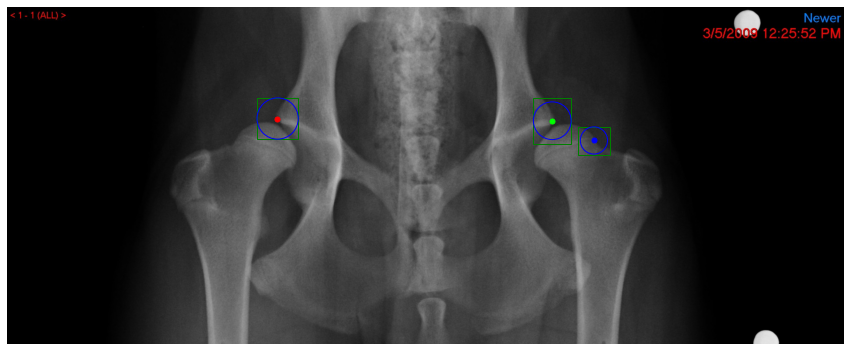

Processing /home/featurize/work/data/data/Valid/images/177424.jpg
pose_results: [<PoseDataSample(

    META INFORMATION
    img_shape: (768, 1908)
    flip_indices: [0]
    img_path: '/home/featurize/work/data/data/Valid/images/177424.jpg'
    ori_shape: (768, 1908)
    input_size: (256, 256)

    DATA FIELDS
    gt_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_centers: array([[592.5, 324.5]])
            bbox_scores: array([1.], dtype=float32)
            bboxes: array([[544, 280, 641, 369]])
            bbox_scales: array([[121.25, 121.25]])
        ) at 0x7facdfdd6f50>
    gt_instance_labels: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
        ) at 0x7facdfdd63d0>
    pred_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_scores: array([1.], dtype=float32)
            bboxes: array([[544, 280, 641, 369]])
      

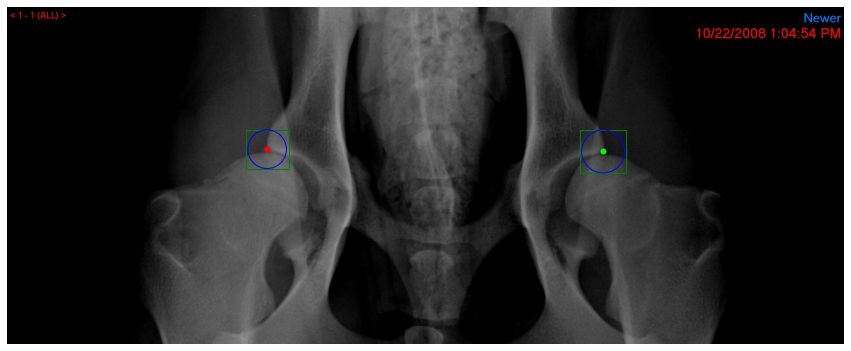

Processing /home/featurize/work/data/data/Valid/images/161797.jpg
pose_results: [<PoseDataSample(

    META INFORMATION
    img_shape: (768, 1908)
    flip_indices: [0]
    img_path: '/home/featurize/work/data/data/Valid/images/161797.jpg'
    ori_shape: (768, 1908)
    input_size: (256, 256)

    DATA FIELDS
    gt_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_centers: array([[696.5, 272.5]])
            bbox_scores: array([1.], dtype=float32)
            bboxes: array([[646, 224, 747, 321]])
            bbox_scales: array([[126.25, 126.25]])
        ) at 0x7fab8b4fc7d0>
    gt_instance_labels: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
        ) at 0x7fab8b4fc290>
    pred_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_scores: array([1.], dtype=float32)
            bboxes: array([[646, 224, 747, 321]])
      

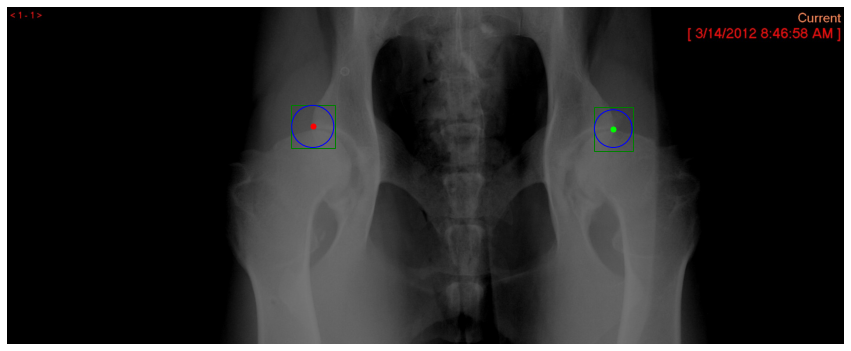

Processing /home/featurize/work/data/data/Valid/images/187156.jpg
pose_results: [<PoseDataSample(

    META INFORMATION
    img_shape: (768, 1908)
    flip_indices: [0]
    img_path: '/home/featurize/work/data/data/Valid/images/187156.jpg'
    ori_shape: (768, 1908)
    input_size: (256, 256)

    DATA FIELDS
    gt_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_centers: array([[1425.5,  326.5]])
            bbox_scores: array([1.], dtype=float32)
            bboxes: array([[1372,  272, 1479,  381]])
            bbox_scales: array([[136.25, 136.25]])
        ) at 0x7fab8a3efa90>
    gt_instance_labels: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
        ) at 0x7fab8b563f90>
    pred_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_scores: array([1.], dtype=float32)
            bboxes: array([[1372,  272, 1479,  381

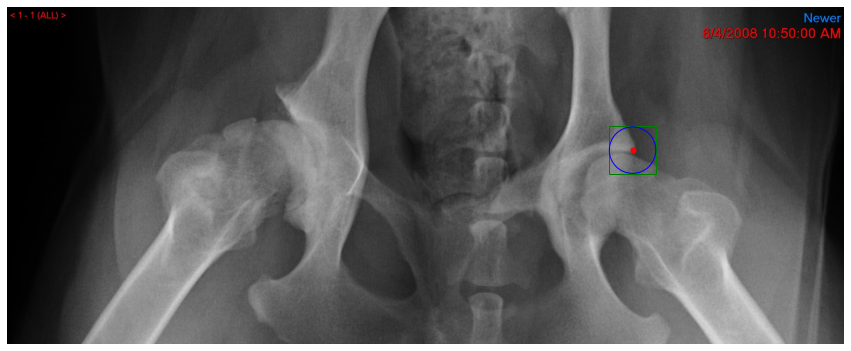

Processing /home/featurize/work/data/data/Valid/images/192237.jpg
pose_results: [<PoseDataSample(

    META INFORMATION
    img_shape: (2500, 2048)
    flip_indices: [0]
    img_path: '/home/featurize/work/data/data/Valid/images/192237.jpg'
    ori_shape: (2500, 2048)
    input_size: (256, 256)

    DATA FIELDS
    gt_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_centers: array([[1390. ,  468.5]])
            bbox_scores: array([1.], dtype=float32)
            bboxes: array([[1321,  400, 1459,  537]])
            bbox_scales: array([[172.5, 172.5]])
        ) at 0x7fab8b913e90>
    gt_instance_labels: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
        ) at 0x7fab8b913b50>
    pred_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_scores: array([1.], dtype=float32)
            bboxes: array([[1321,  400, 1459,  537

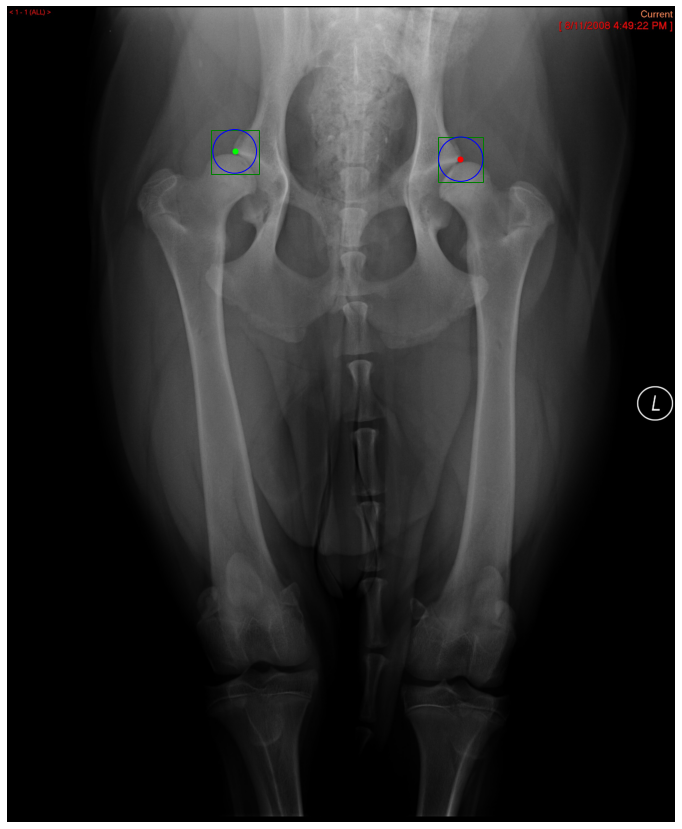

Processing /home/featurize/work/data/data/Valid/images/217378.jpg
pose_results: [<PoseDataSample(

    META INFORMATION
    img_shape: (4200, 3408)
    flip_indices: [0]
    img_path: '/home/featurize/work/data/data/Valid/images/217378.jpg'
    ori_shape: (4200, 3408)
    input_size: (256, 256)

    DATA FIELDS
    gt_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_centers: array([[2198. , 1356.5]])
            bbox_scores: array([1.], dtype=float32)
            bboxes: array([[2082, 1233, 2314, 1480]])
            bbox_scales: array([[308.75, 308.75]])
        ) at 0x7fab8bb85a50>
    gt_instance_labels: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
        ) at 0x7fab8bb85a10>
    pred_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_scores: array([1.], dtype=float32)
            bboxes: array([[2082, 1233, 2314, 14

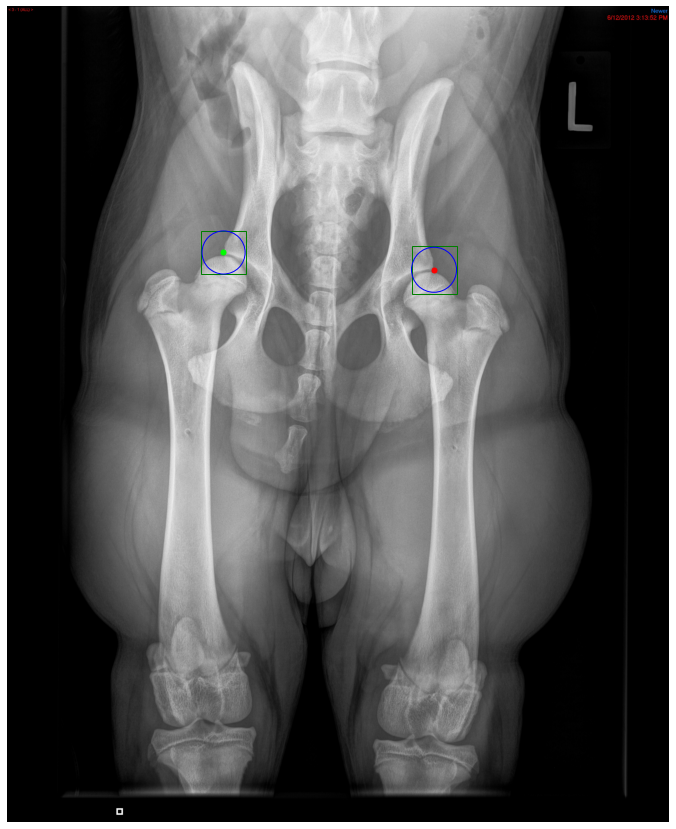

Processing /home/featurize/work/data/data/Valid/images/201697.jpg
Processing /home/featurize/work/data/data/Valid/images/201935.jpg
pose_results: [<PoseDataSample(

    META INFORMATION
    img_shape: (768, 1908)
    flip_indices: [0]
    img_path: '/home/featurize/work/data/data/Valid/images/201935.jpg'
    ori_shape: (768, 1908)
    input_size: (256, 256)

    DATA FIELDS
    gt_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_centers: array([[599. , 324.5]])
            bbox_scores: array([1.], dtype=float32)
            bboxes: array([[547, 272, 651, 377]])
            bbox_scales: array([[131.25, 131.25]])
        ) at 0x7face0079e50>
    gt_instance_labels: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
        ) at 0x7face0079a50>
    pred_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_scores: array([1.], dtype

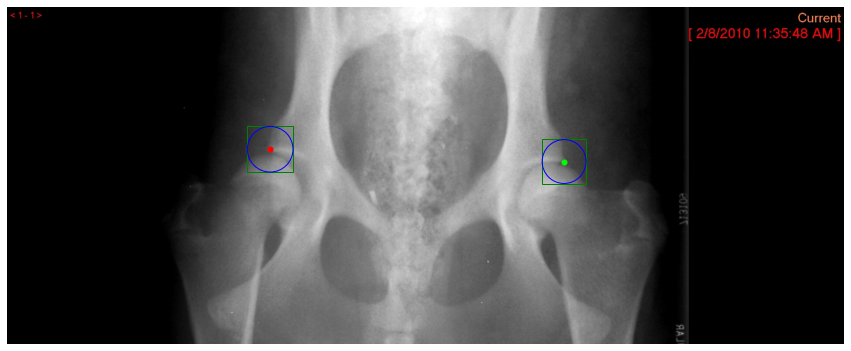

Processing /home/featurize/work/data/data/Valid/images/218026.jpg
pose_results: [<PoseDataSample(

    META INFORMATION
    img_shape: (4200, 3408)
    flip_indices: [0]
    img_path: '/home/featurize/work/data/data/Valid/images/218026.jpg'
    ori_shape: (4200, 3408)
    input_size: (256, 256)

    DATA FIELDS
    gt_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_centers: array([[1285., 1268.]])
            bbox_scores: array([1.], dtype=float32)
            bboxes: array([[1184, 1170, 1386, 1366]])
            bbox_scales: array([[252.5, 252.5]])
        ) at 0x7fab8b640690>
    gt_instance_labels: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
        ) at 0x7fab8b640090>
    pred_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_scores: array([1.], dtype=float32)
            bboxes: array([[1184, 1170, 1386, 1366]]

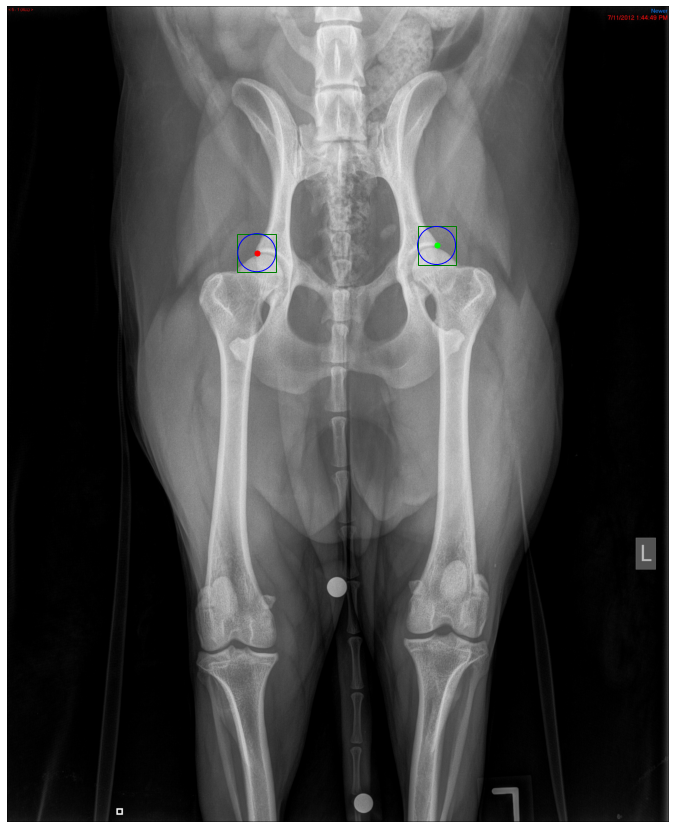

Processing /home/featurize/work/data/data/Valid/images/172118.jpg
pose_results: [<PoseDataSample(

    META INFORMATION
    img_shape: (768, 1908)
    flip_indices: [0]
    img_path: '/home/featurize/work/data/data/Valid/images/172118.jpg'
    ori_shape: (768, 1908)
    input_size: (256, 256)

    DATA FIELDS
    gt_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_centers: array([[757., 355.]])
            bbox_scores: array([1.], dtype=float32)
            bboxes: array([[711, 309, 803, 401]])
            bbox_scales: array([[115., 115.]])
        ) at 0x7fab8b95d910>
    gt_instance_labels: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
        ) at 0x7fab8b95de90>
    pred_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_scores: array([1.], dtype=float32)
            bboxes: array([[711, 309, 803, 401]])
            

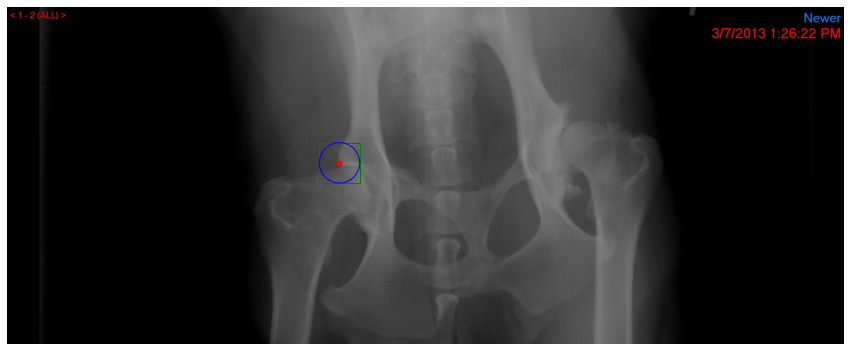

Processing /home/featurize/work/data/data/Valid/images/190237.jpg
pose_results: [<PoseDataSample(

    META INFORMATION
    img_shape: (768, 1908)
    flip_indices: [0]
    img_path: '/home/featurize/work/data/data/Valid/images/190237.jpg'
    ori_shape: (768, 1908)
    input_size: (256, 256)

    DATA FIELDS
    gt_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_centers: array([[1358.,  290.]])
            bbox_scores: array([1.], dtype=float32)
            bboxes: array([[1306,  237, 1410,  343]])
            bbox_scales: array([[132.5, 132.5]])
        ) at 0x7fab8b935710>
    gt_instance_labels: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
        ) at 0x7fab8b935cd0>
    pred_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_scores: array([1.], dtype=float32)
            bboxes: array([[1306,  237, 1410,  343]])


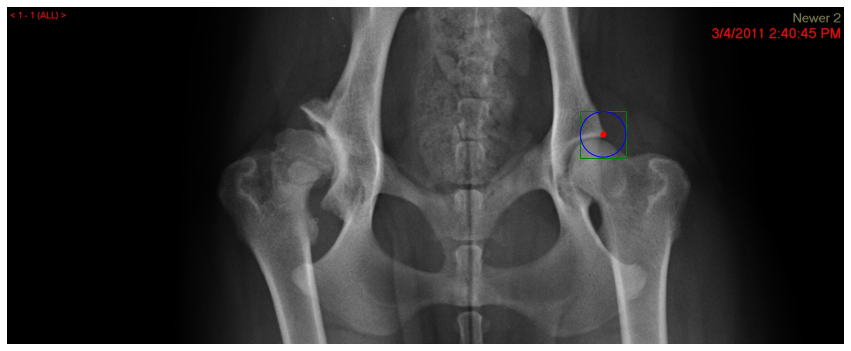

Processing /home/featurize/work/data/data/Valid/images/197232.jpg
pose_results: [<PoseDataSample(

    META INFORMATION
    img_shape: (768, 1908)
    flip_indices: [0]
    img_path: '/home/featurize/work/data/data/Valid/images/197232.jpg'
    ori_shape: (768, 1908)
    input_size: (256, 256)

    DATA FIELDS
    gt_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_centers: array([[578., 266.]])
            bbox_scores: array([1.], dtype=float32)
            bboxes: array([[524, 212, 632, 320]])
            bbox_scales: array([[135., 135.]])
        ) at 0x7fab8b8ed250>
    gt_instance_labels: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
        ) at 0x7fab8b8edc10>
    pred_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_scores: array([1.], dtype=float32)
            bboxes: array([[524, 212, 632, 320]])
            

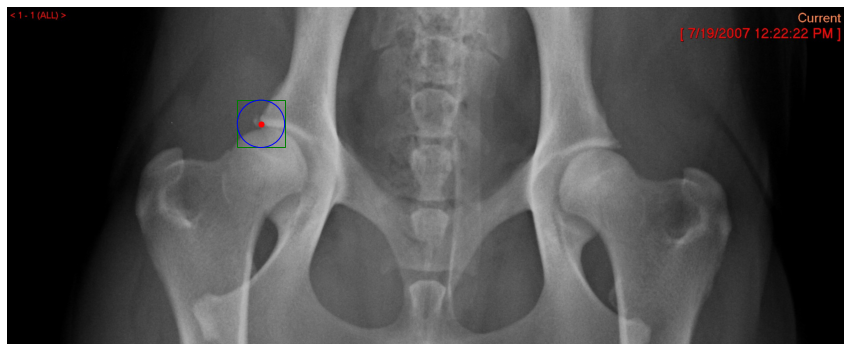

Processing /home/featurize/work/data/data/Valid/images/218690.jpg
pose_results: [<PoseDataSample(

    META INFORMATION
    img_shape: (756, 1908)
    flip_indices: [0]
    img_path: '/home/featurize/work/data/data/Valid/images/218690.jpg'
    ori_shape: (756, 1908)
    input_size: (256, 256)

    DATA FIELDS
    gt_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_centers: array([[1295.5,  325.5]])
            bbox_scores: array([1.], dtype=float32)
            bboxes: array([[1247,  275, 1344,  376]])
            bbox_scales: array([[126.25, 126.25]])
        ) at 0x7fab8b6d0c50>
    gt_instance_labels: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
        ) at 0x7fab8b6d0f50>
    pred_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_scores: array([1.], dtype=float32)
            bboxes: array([[1247,  275, 1344,  376

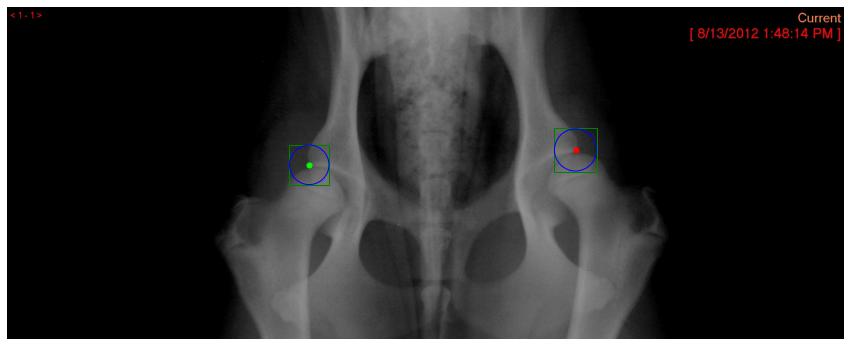

Processing /home/featurize/work/data/data/Valid/images/215195.jpg
Processing /home/featurize/work/data/data/Valid/images/184896.jpg
pose_results: [<PoseDataSample(

    META INFORMATION
    img_shape: (2500, 2048)
    flip_indices: [0]
    img_path: '/home/featurize/work/data/data/Valid/images/184896.jpg'
    ori_shape: (2500, 2048)
    input_size: (256, 256)

    DATA FIELDS
    gt_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_centers: array([[1288.5, 1182.5]])
            bbox_scores: array([1.], dtype=float32)
            bboxes: array([[1227, 1121, 1350, 1244]])
            bbox_scales: array([[153.75, 153.75]])
        ) at 0x7fab8ba34990>
    gt_instance_labels: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
        ) at 0x7fab8ba34d10>
    pred_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_scores: array([1.

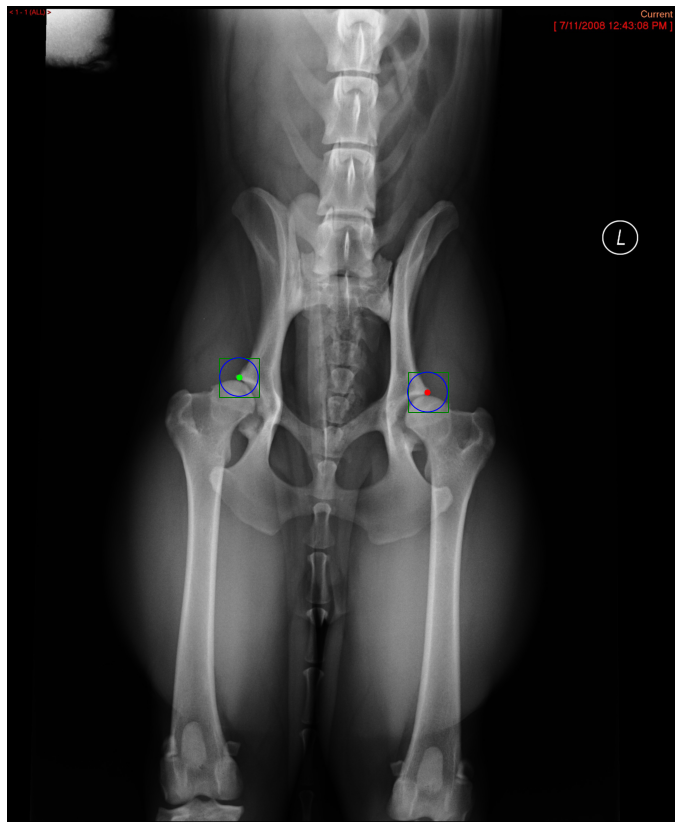

Processing /home/featurize/work/data/data/Valid/images/198301.jpg
pose_results: [<PoseDataSample(

    META INFORMATION
    img_shape: (768, 1908)
    flip_indices: [0]
    img_path: '/home/featurize/work/data/data/Valid/images/198301.jpg'
    ori_shape: (768, 1908)
    input_size: (256, 256)

    DATA FIELDS
    gt_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_centers: array([[1384.,  322.]])
            bbox_scores: array([1.], dtype=float32)
            bboxes: array([[1331,  271, 1437,  373]])
            bbox_scales: array([[132.5, 132.5]])
        ) at 0x7fab8b9cef90>
    gt_instance_labels: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
        ) at 0x7fab8b9ceb50>
    pred_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_scores: array([1.], dtype=float32)
            bboxes: array([[1331,  271, 1437,  373]])


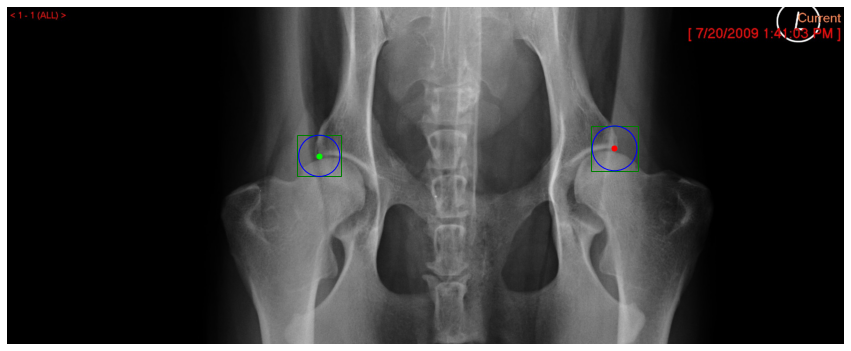

Processing /home/featurize/work/data/data/Valid/images/184956.jpg
pose_results: [<PoseDataSample(

    META INFORMATION
    img_shape: (768, 1908)
    flip_indices: [0]
    img_path: '/home/featurize/work/data/data/Valid/images/184956.jpg'
    ori_shape: (768, 1908)
    input_size: (256, 256)

    DATA FIELDS
    gt_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_centers: array([[1290. ,  305.5]])
            bbox_scores: array([1.], dtype=float32)
            bboxes: array([[1239,  255, 1341,  356]])
            bbox_scales: array([[127.5, 127.5]])
        ) at 0x7fab8a31b0d0>
    gt_instance_labels: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
        ) at 0x7fab8a31bb50>
    pred_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            bbox_scores: array([1.], dtype=float32)
            bboxes: array([[1239,  255, 1341,  356]]

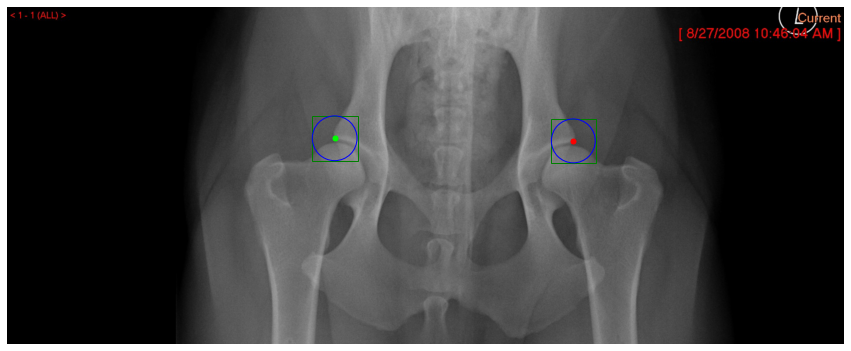

In [ ]:
img_dir = '/home/featurize/work/data/data/Valid/images'
image_files = [f for f in os.listdir(img_dir) if f.lower().endswith(('.jpg', '.jpeg', '.png'))]

colors = [
    (255, 0, 0),    # 红色
    (0, 255, 0),    # 绿色
    (0, 0, 255),    # 蓝色
    (255, 255, 0),  # 黄色
]

for image_file in image_files:
    image_path = os.path.join(img_dir, image_file)
    print(f'Processing {image_path}')
    image = imread(image_path)
    
    init_default_scope(detector2.cfg.get('default_scope', 'mmdet'))
    detect_result = inference_detector(detector2, image_path)
    
    CONF_THRES = 0.5

    pred_instance = detect_result.pred_instances.cpu().numpy()
    bboxes = np.concatenate((pred_instance.bboxes, pred_instance.scores[:, None]), axis=1)
    bboxes = bboxes[np.logical_and(pred_instance.labels == 0, pred_instance.scores > CONF_THRES)]
    bboxes = bboxes[nms(bboxes, 0.3)][:, :4].astype('int')
    
    if len(bboxes) > 0:
        pose_results = inference_topdown(pose_estimator2, image_path, bboxes)
        
        # 检查 pose_results 的结构
        print(f'pose_results: {pose_results}')
        
        try:
            data_samples = merge_data_samples(pose_results)
            keypoints = data_samples.pred_instances.keypoints.astype('int')
            print(f'keypoints: {keypoints}')
        except ValueError as e:
            print(f'Error merging data samples: {e}')
            continue
        
        
        #####plot
        fig, ax = plt.subplots(figsize=(15, 15))  
        ax.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
        ax.set_aspect('equal', 'box')

        for idx, bbox in enumerate(bboxes):
            # 绘制边界框
            rect = patches.Rectangle((bbox[0], bbox[1]), bbox[2] - bbox[0], bbox[3] - bbox[1], linewidth=1, edgecolor='g', facecolor='none')
            ax.add_patch(rect)
            
            # 计算并绘制圆圈
            center_x = (bbox[0] + bbox[2]) // 2
            center_y = (bbox[1] + bbox[3]) // 2
            radius = min(bbox[2] - bbox[0], bbox[3] - bbox[1]) // 2
            circle = plt.Circle((center_x, center_y), radius, color='b', fill=False)
            ax.add_patch(circle)
            
            # 绘制关键点
            keypoint = keypoints[idx]
            for x, y in keypoint:
                color = colors[idx % len(colors)]  
                cv2.circle(image, (x, y), 5, color, -1)  
                ax.plot(x, y, 'o', color=np.array(color)/255.0, markersize=5)

        plt.axis('off')
        plt.show()

Processing /home/featurize/work/data/data/Valid/images/162647.jpg
center: [[[ 743  401]]

 [[1352  423]]]
head: [[[1377  354]]

 [[ 726  324]]]


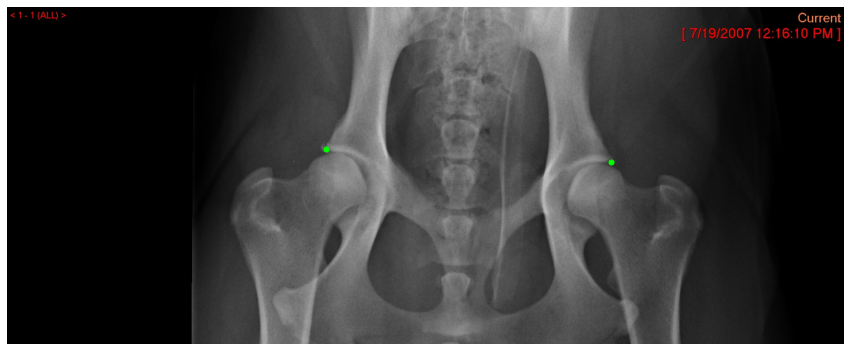

Processing /home/featurize/work/data/data/Valid/images/199118.jpg
center: [[[ 661  347]]

 [[1325  358]]]
head: [[[1343  280]]

 [[ 647  268]]]


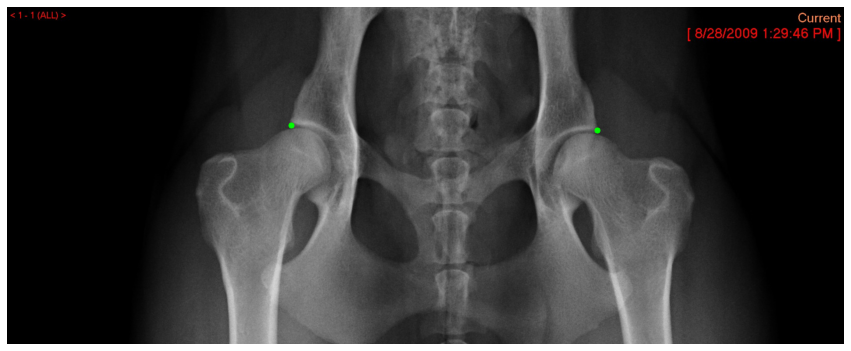

Processing /home/featurize/work/data/data/Valid/images/177494.jpg
head: [[[ 757  250]]

 [[1322  335]]

 [[ 684  284]]]


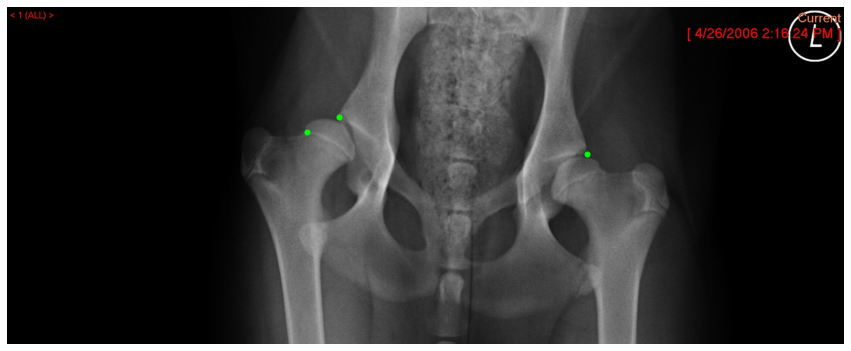

Processing /home/featurize/work/data/data/Valid/images/182979.jpg
head: [[[655 334]]]


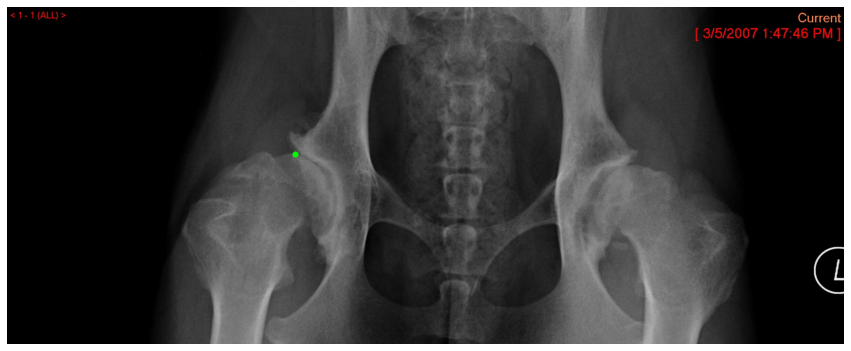

Processing /home/featurize/work/data/data/Valid/images/208621.jpg
head: [[[ 612  235]]

 [[1368  299]]]


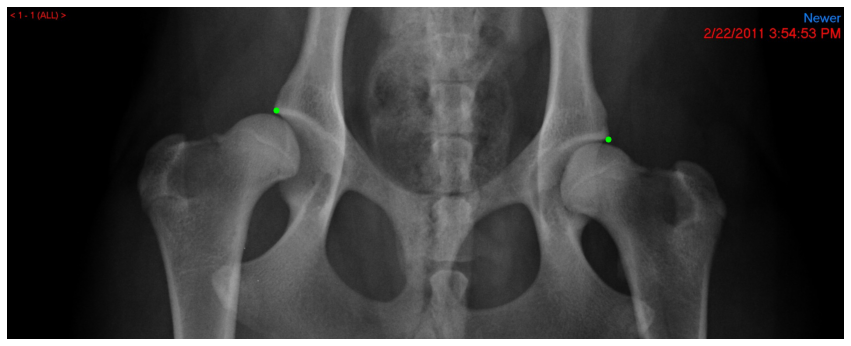

Processing /home/featurize/work/data/data/Valid/images/172203.jpg


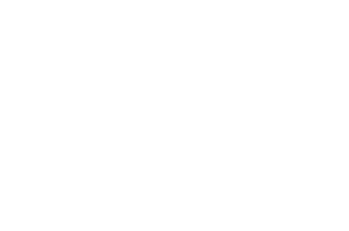

Processing /home/featurize/work/data/data/Valid/images/165569.jpg
center: [[[1296  363]]

 [[ 810  363]]]
head: [[[ 792  306]]

 [[1314  306]]]


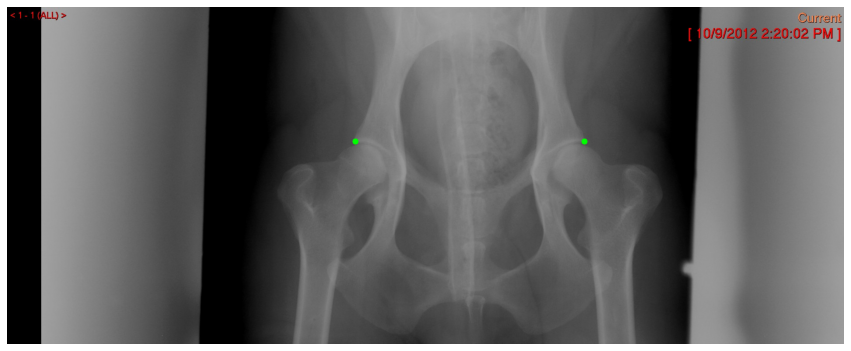

Processing /home/featurize/work/data/data/Valid/images/173119.jpg
center: [[[ 805  471]]

 [[1424  527]]]
head: [[[ 802  392]]

 [[1453  453]]]


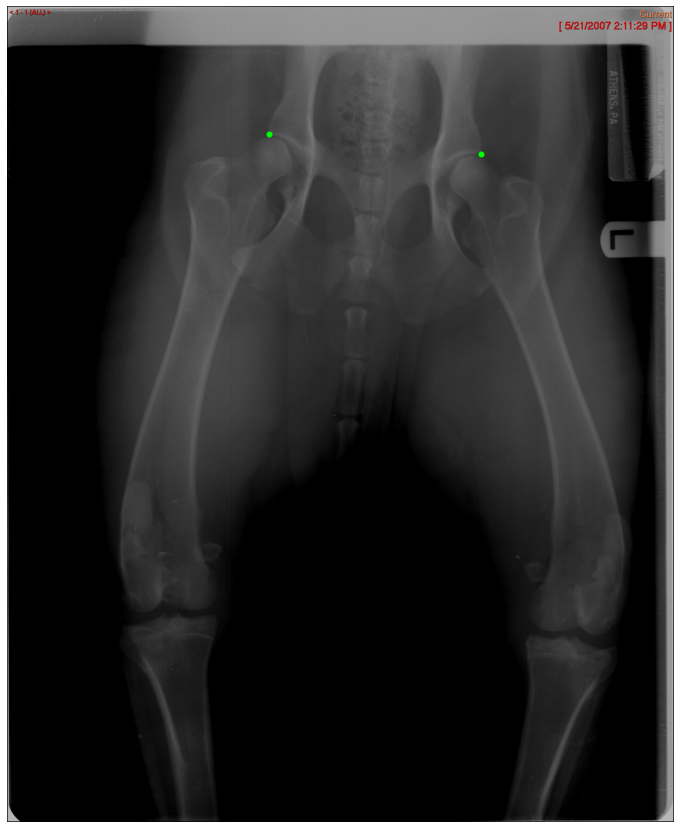

Processing /home/featurize/work/data/data/Valid/images/191789.jpg
center: [[[ 589  725]]

 [[1219  719]]]
head: [[[1229  637]]

 [[ 579  640]]]


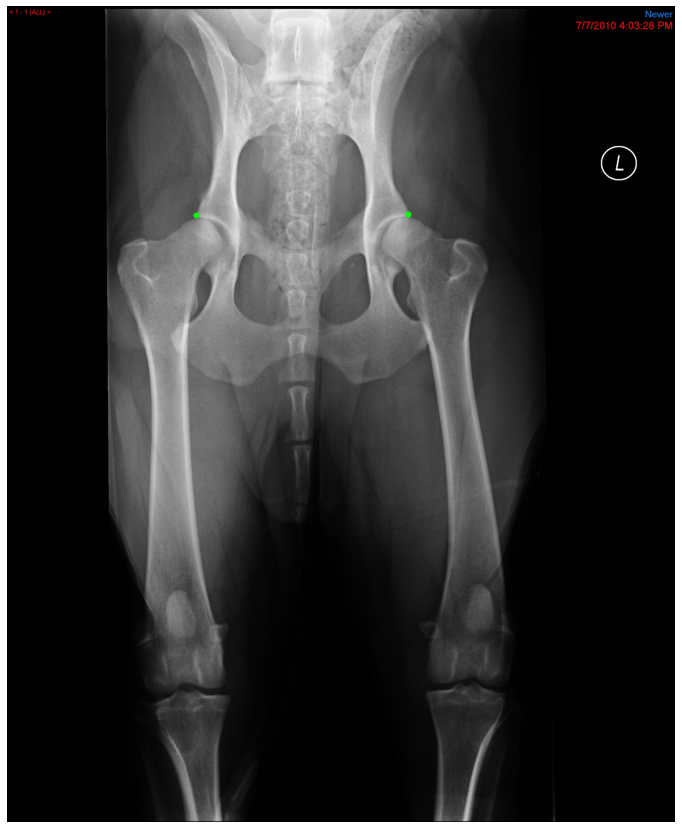

Processing /home/featurize/work/data/data/Valid/images/195849.jpg
head: [[[1287  259]]

 [[ 651  215]]

 [[1365  318]]]


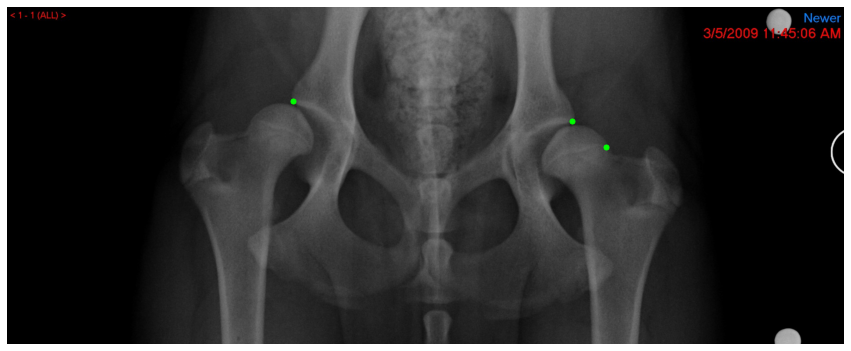

Processing /home/featurize/work/data/data/Valid/images/207341.jpg
head: [[[1298  258]]]


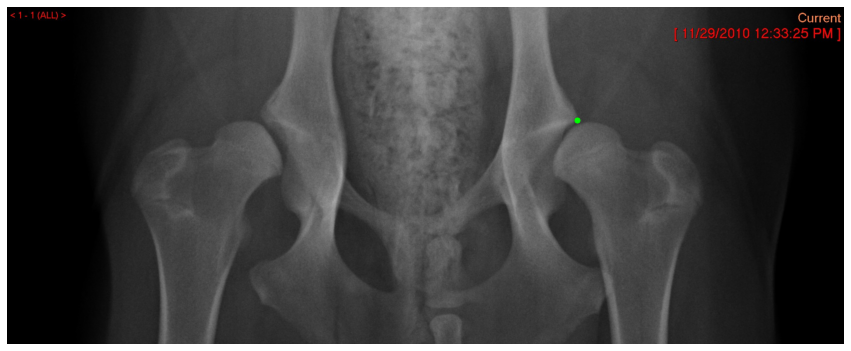

Processing /home/featurize/work/data/data/Valid/images/194495.jpg
center: [[[1394  363]]]
head: [[[ 787  332]]

 [[1406  296]]]


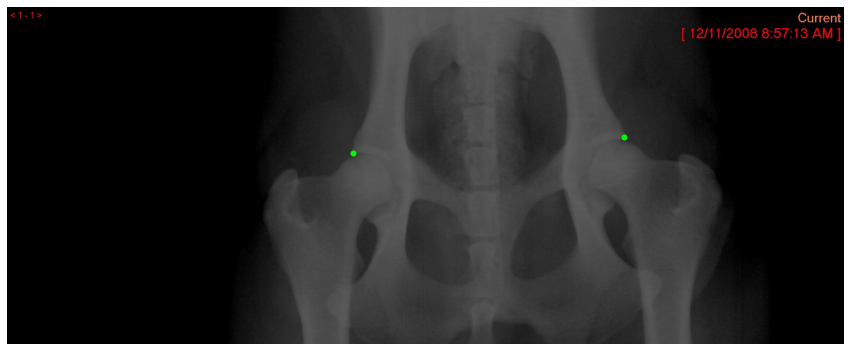

Processing /home/featurize/work/data/data/Valid/images/194955.jpg
head: [[[1459  343]]

 [[ 715  266]]]


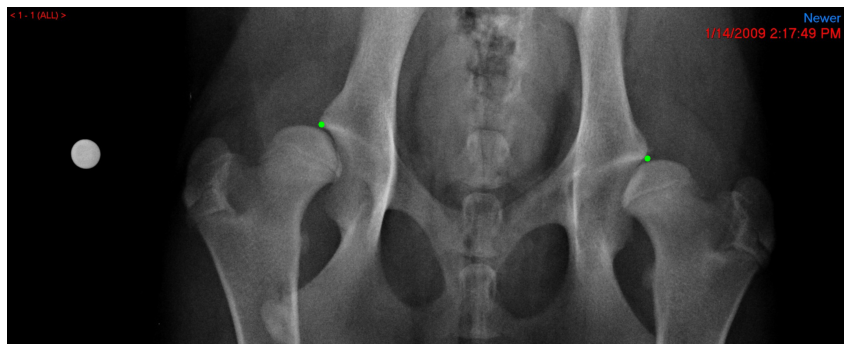

Processing /home/featurize/work/data/data/Valid/images/208763.jpg
head: [[[ 686  258]]

 [[1442  282]]]


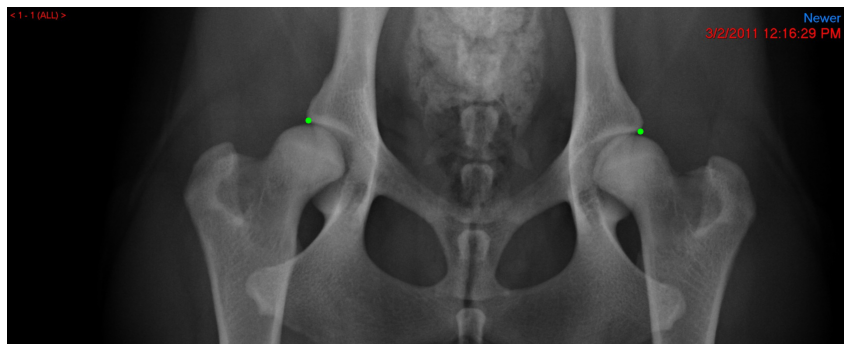

Processing /home/featurize/work/data/data/Valid/images/195827.jpg
head: [[[ 615  254]]

 [[1242  259]]

 [[1337  304]]]


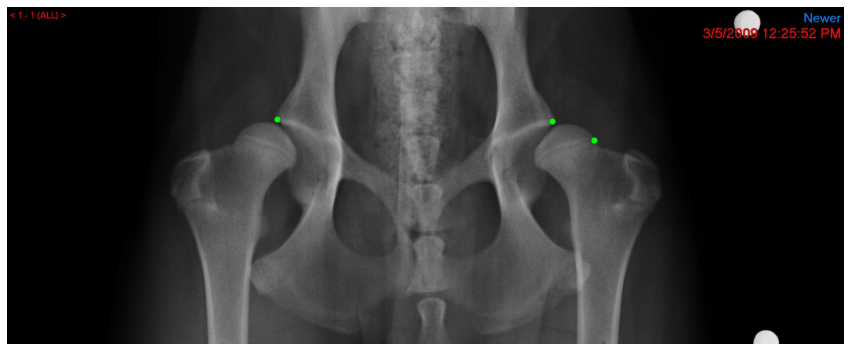

Processing /home/featurize/work/data/data/Valid/images/177424.jpg
head: [[[ 592  324]]

 [[1358  329]]]


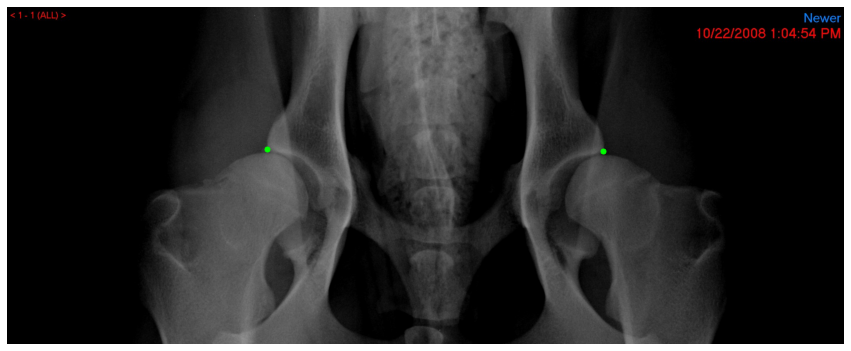

Processing /home/featurize/work/data/data/Valid/images/161797.jpg
head: [[[ 696  272]]

 [[1381  277]]]


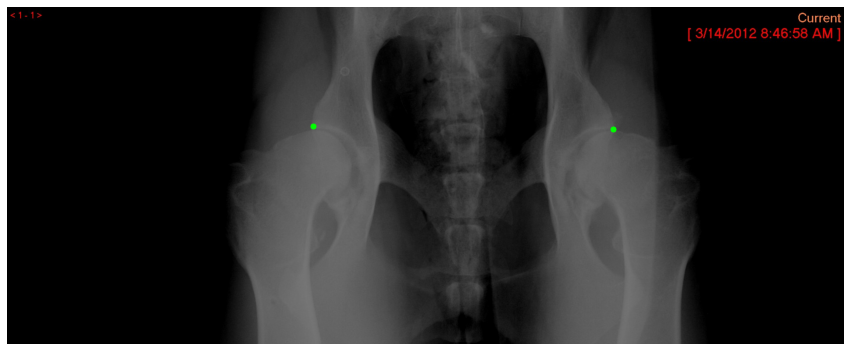

Processing /home/featurize/work/data/data/Valid/images/187156.jpg
head: [[[1425  326]]]


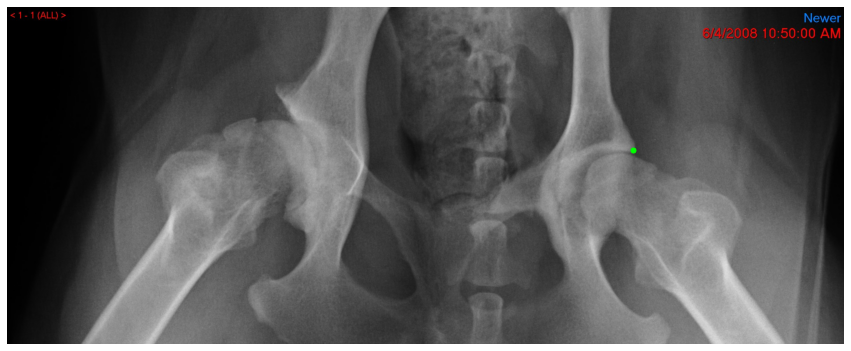

Processing /home/featurize/work/data/data/Valid/images/192237.jpg
center: [[[ 679  534]]

 [[1408  559]]]
head: [[[1389  468]]

 [[ 697  444]]]


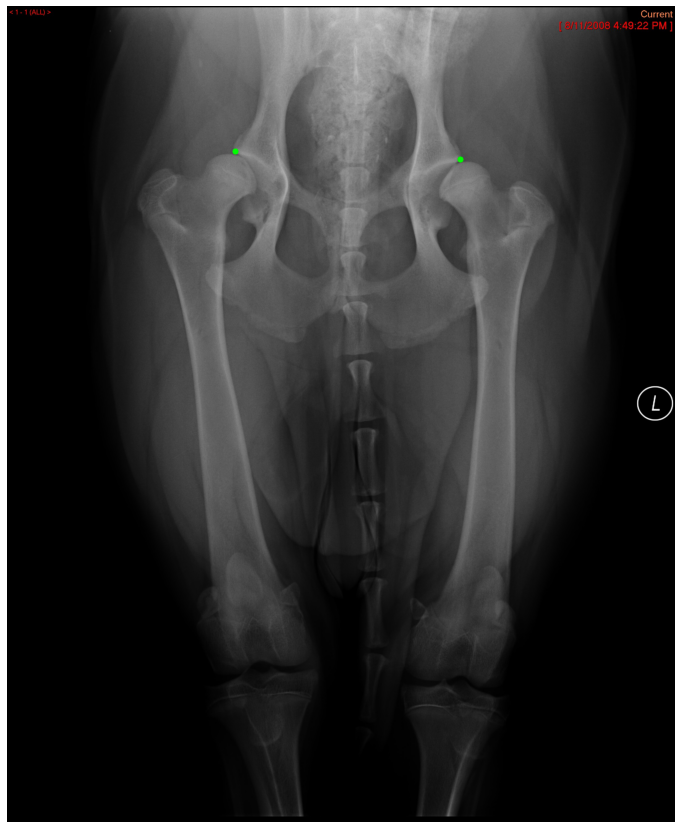

Processing /home/featurize/work/data/data/Valid/images/217378.jpg
center: [[[1107 1423]]

 [[2174 1508]]]
head: [[[2197 1356]]

 [[1113 1267]]]


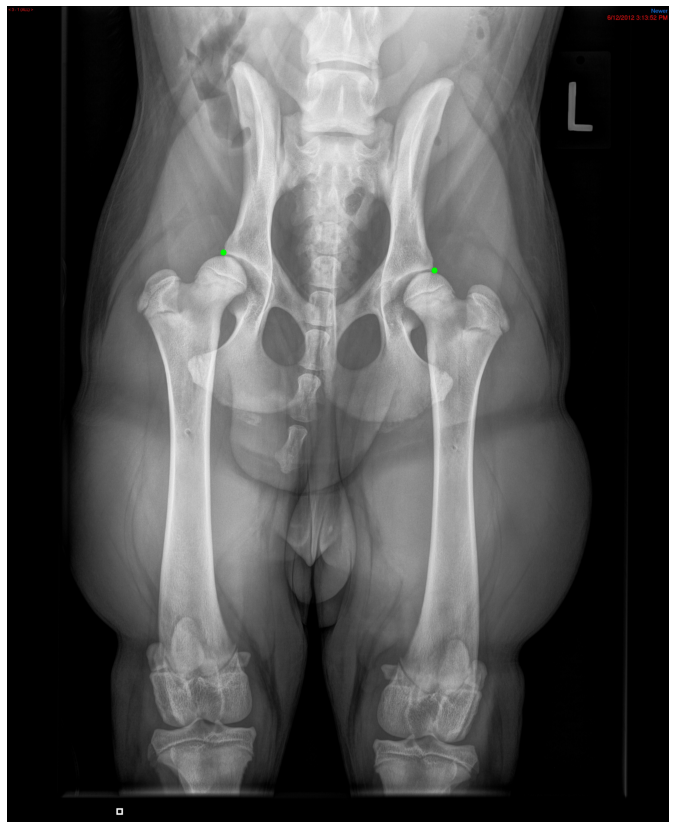

Processing /home/featurize/work/data/data/Valid/images/201697.jpg


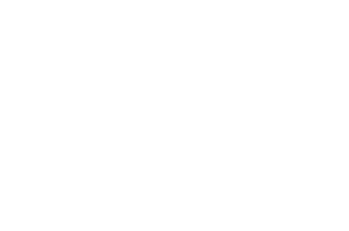

Processing /home/featurize/work/data/data/Valid/images/201935.jpg
head: [[[ 599  324]]

 [[1268  352]]]


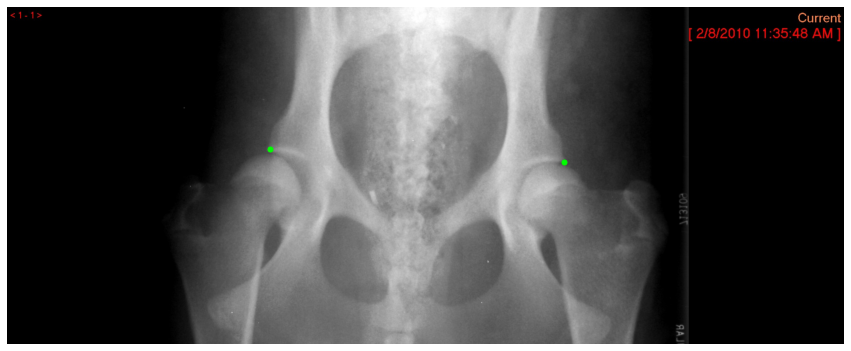

Processing /home/featurize/work/data/data/Valid/images/218026.jpg
center: [[[2188 1352]]

 [[1316 1386]]]
head: [[[1285 1268]]

 [[2211 1231]]]


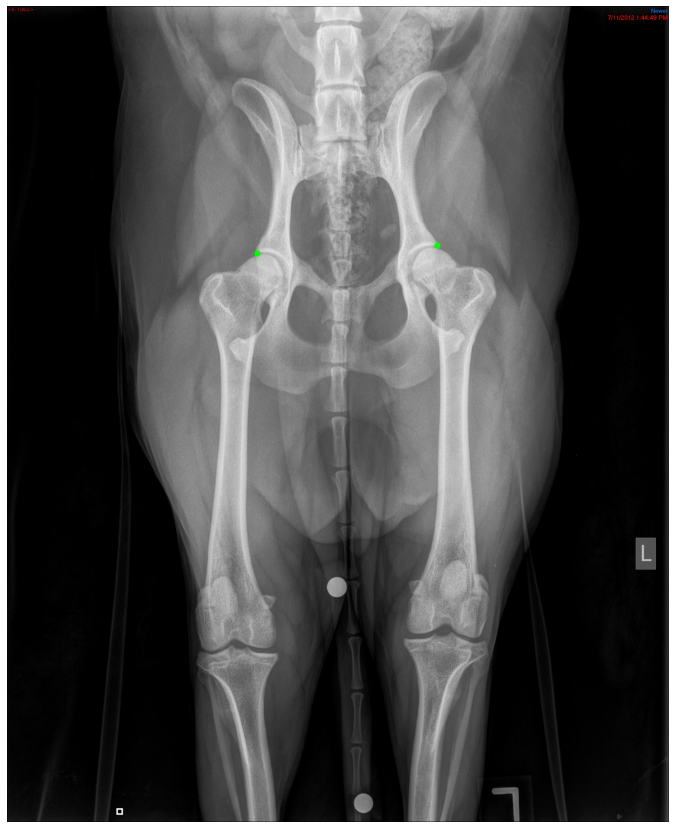

Processing /home/featurize/work/data/data/Valid/images/172118.jpg
center: [[[775 412]]]
head: [[[756 355]]]


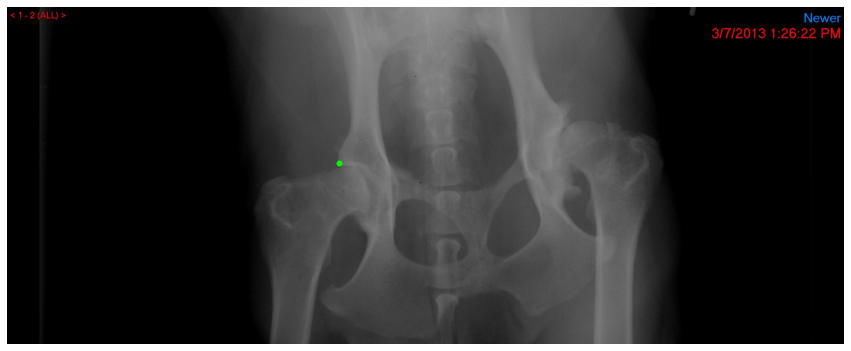

Processing /home/featurize/work/data/data/Valid/images/190237.jpg
center: [[[1340  359]]]
head: [[[1358  290]]]


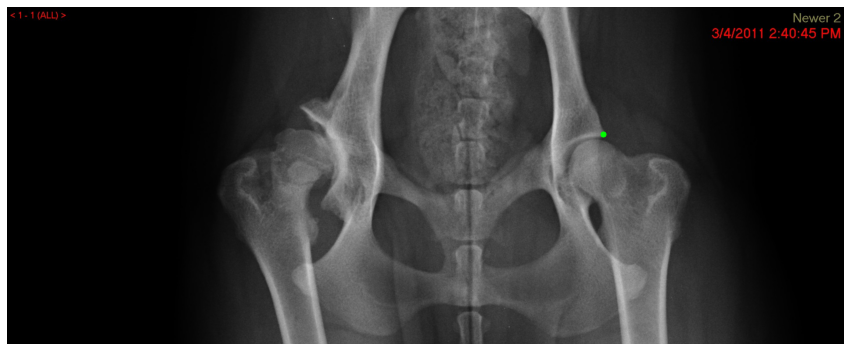

Processing /home/featurize/work/data/data/Valid/images/197232.jpg
head: [[[578 266]]]


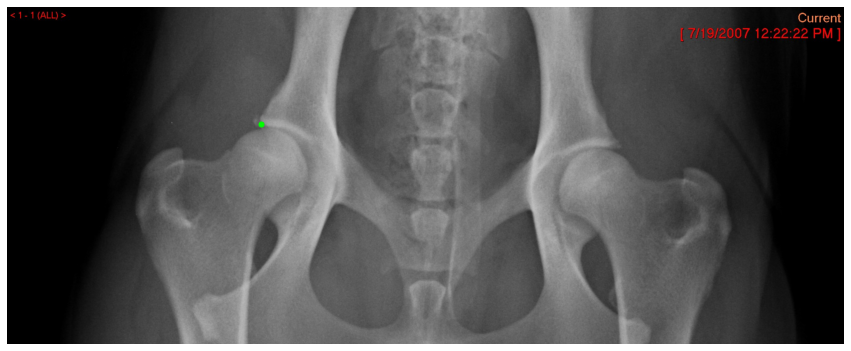

Processing /home/featurize/work/data/data/Valid/images/218690.jpg
head: [[[1295  325]]

 [[ 688  359]]]


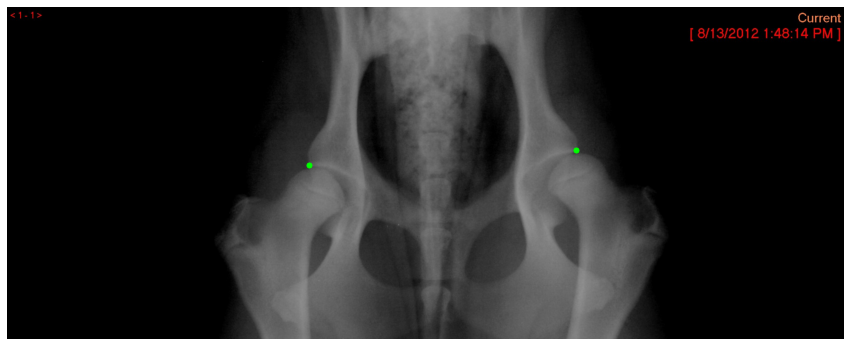

Processing /home/featurize/work/data/data/Valid/images/215195.jpg


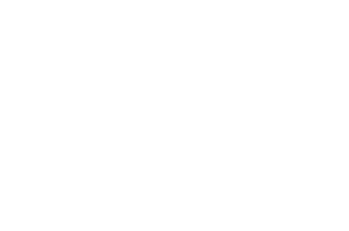

Processing /home/featurize/work/data/data/Valid/images/184896.jpg
center: [[[ 696 1213]]

 [[1285 1259]]]
head: [[[1288 1182]]

 [[ 710 1136]]]


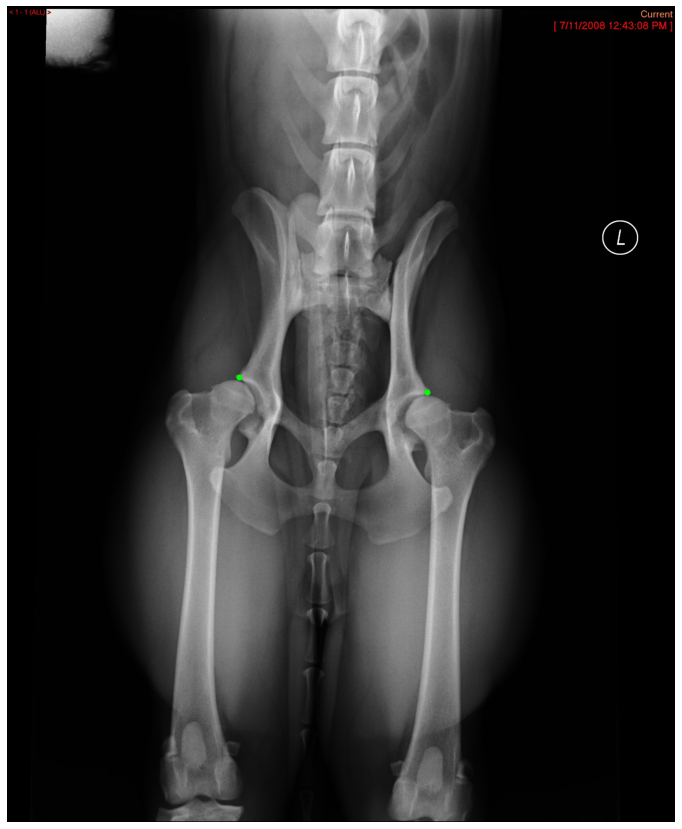

Processing /home/featurize/work/data/data/Valid/images/198301.jpg
head: [[[1383  322]]

 [[ 711  339]]]


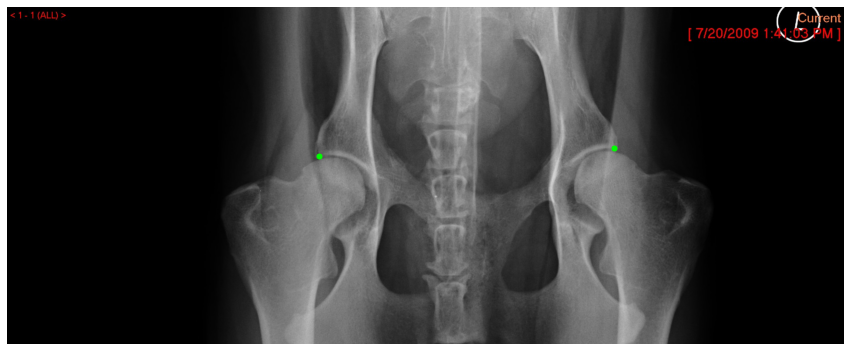

Processing /home/featurize/work/data/data/Valid/images/184956.jpg
center: [[[ 753  365]]

 [[1281  370]]]
head: [[[1290  305]]

 [[ 746  299]]]


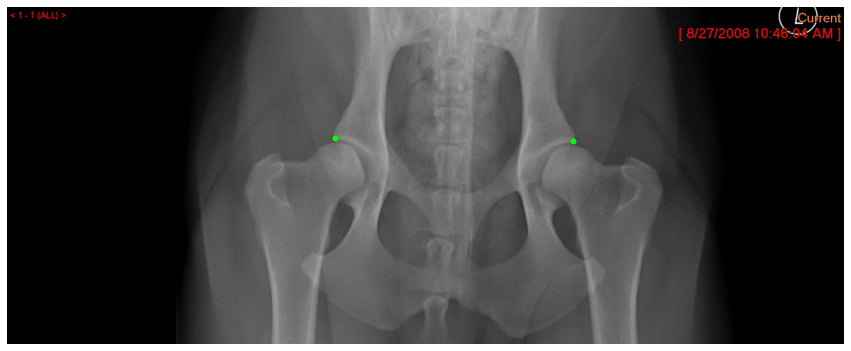

In [ ]:
img_dir = '/home/featurize/work/data/data/Valid/images'
image_files = [f for f in os.listdir(img_dir) if f.lower().endswith(('.jpg', '.jpeg', '.png'))]

colors = [
    (255, 0, 0),    # 红色
    (0, 255, 0),    # 绿色
    (0, 0, 255),    # 蓝色
    (255, 255, 0),  # 黄色
]

for image_file in image_files:
    image_path = os.path.join(img_dir, image_file)
    print(f'Processing {image_path}')
    image = imread(image_path)
    
    init_default_scope(detector.cfg.get('default_scope', 'mmdet'))
    
    ## center
    detect_result_center = inference_detector(detector, image_path)
    
    CONF_THRES = 0.9

    pred_instance_center = detect_result_center.pred_instances.cpu().numpy()
    bboxes = np.concatenate((pred_instance_center.bboxes, pred_instance_center.scores[:, None]), axis=1)
    bboxes = bboxes[np.logical_and(pred_instance_center.labels == 0, pred_instance_center.scores > CONF_THRES)]
    bboxes = bboxes[nms(bboxes, 0.3)][:, :4].astype('int')
    
    if len(bboxes) > 0:
        pose_results_center = inference_topdown(pose_estimator, image_path, bboxes)
        
        # 检查 pose_results 的结构
        #print(f'pose_results: {pose_results_center}')
        
        try:
            data_samples = merge_data_samples(pose_results_center)
            keypoints = data_samples.pred_instances.keypoints.astype('int')
            print(f'keypoints: {keypoints}')
        except ValueError as e:
            print(f'Error merging data samples: {e}')
            continue
        
    ## head   
    detect_result_head = inference_detector(detector2, image_path)
    
    CONF_THRES = 0.5

    pred_instance_head = detect_result_head.pred_instances.cpu().numpy()
    bboxes = np.concatenate((pred_instance_head.bboxes, pred_instance_head.scores[:, None]), axis=1)
    bboxes = bboxes[np.logical_and(pred_instance_head.labels == 0, pred_instance_head.scores > CONF_THRES)]
    bboxes = bboxes[nms(bboxes, 0.3)][:, :4].astype('int')
    
    if len(bboxes) > 0:
        pose_results_head = inference_topdown(pose_estimator2, image_path, bboxes)
        
        # 检查 pose_results 的结构
        #print(f'pose_results: {pose_results_head}')
        
        try:
            data_samples = merge_data_samples(pose_results_head)
            keypoints = data_samples.pred_instances.keypoints.astype('int')
            print(f'keypoints: {keypoints}')
        except ValueError as e:
            print(f'Error merging data samples: {e}')
            continue
        
        #####plot
        fig, ax = plt.subplots(figsize=(15, 15))  
        ax.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
        ax.set_aspect('equal', 'box')

        for idx, bbox in enumerate(bboxes):
           
            # 绘制关键点
            keypoint = keypoints[idx]
            for x, y in keypoint:
                cv2.circle(image, (x, y), 5, color, -1)  
                ax.plot(x, y, 'o', color=np.array(color)/255.0, markersize=5)

        plt.axis('off')
        plt.show()

Processing /home/featurize/work/data/data/Valid/images/162647.jpg
center: [[[ 743  401]]

 [[1352  423]]]
head: [[[1377  354]]

 [[ 726  324]]]


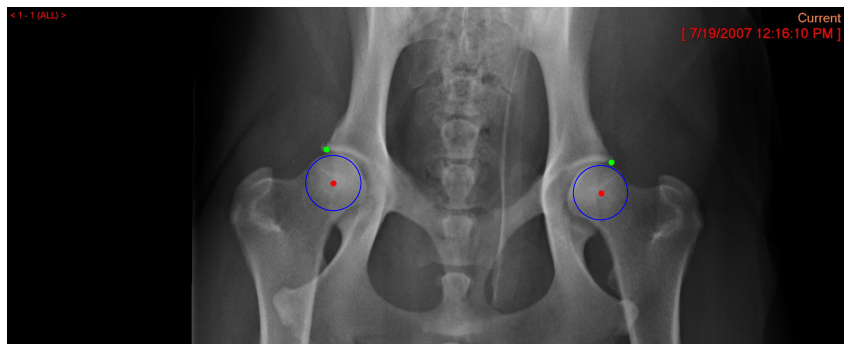

Processing /home/featurize/work/data/data/Valid/images/199118.jpg
center: [[[ 661  347]]

 [[1325  358]]]
head: [[[1343  280]]

 [[ 647  268]]]


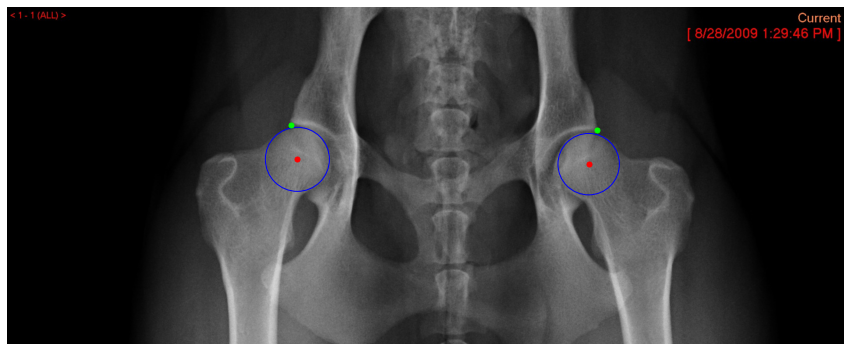

Processing /home/featurize/work/data/data/Valid/images/177494.jpg
center: [[[1315  405]]

 [[ 714  328]]]
head: [[[ 757  250]]

 [[1322  335]]

 [[ 684  284]]]


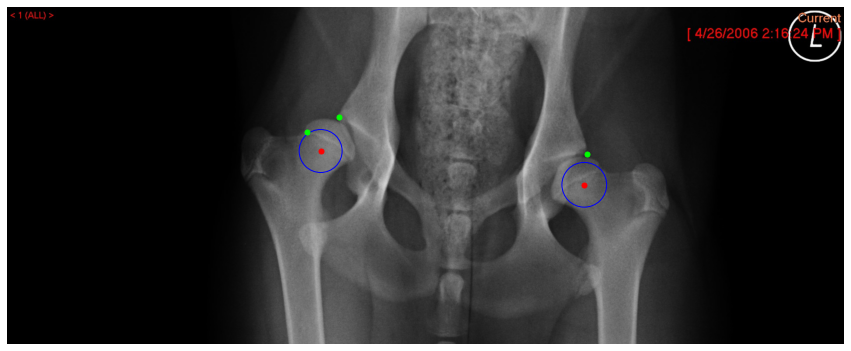

Processing /home/featurize/work/data/data/Valid/images/182979.jpg
center: [[[654 387]]]
head: [[[655 334]]]


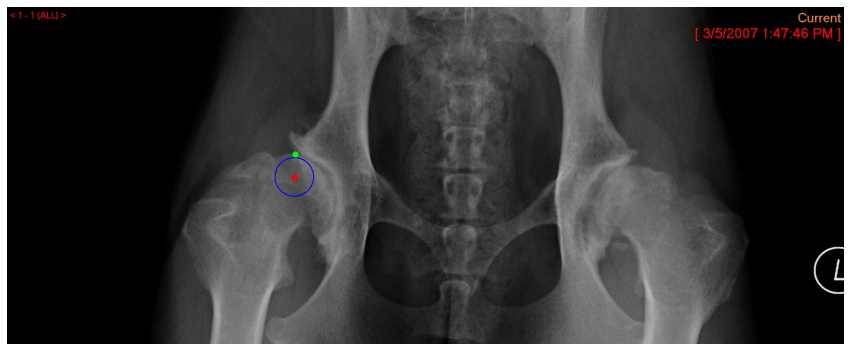

Processing /home/featurize/work/data/data/Valid/images/208621.jpg
center: [[[577 309]]]
head: [[[ 612  235]]

 [[1368  299]]]


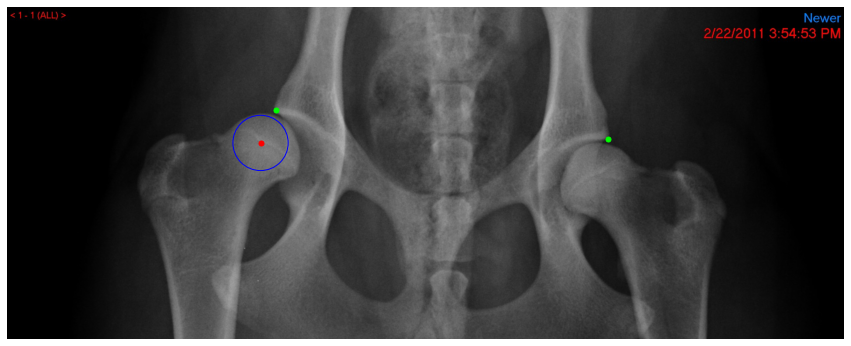

Processing /home/featurize/work/data/data/Valid/images/172203.jpg


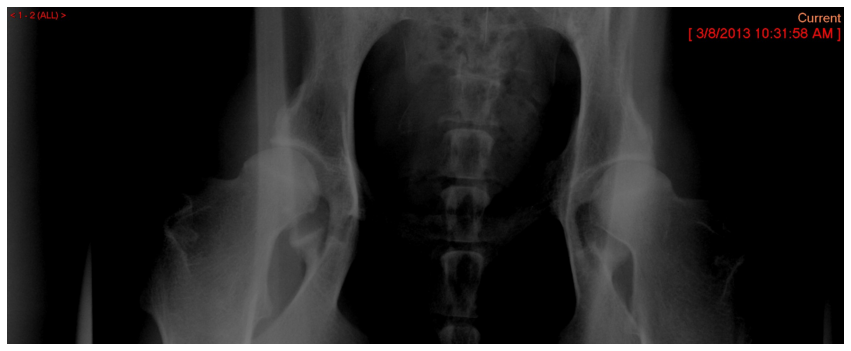

Processing /home/featurize/work/data/data/Valid/images/165569.jpg
center: [[[1296  363]]

 [[ 810  363]]]
head: [[[ 792  306]]

 [[1314  306]]]


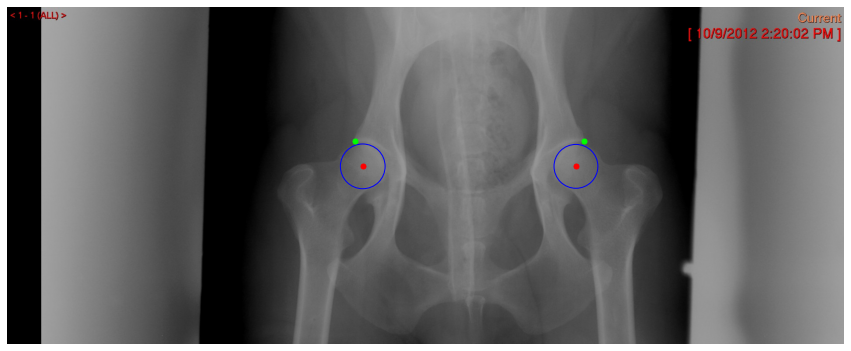

Processing /home/featurize/work/data/data/Valid/images/173119.jpg
center: [[[ 805  471]]

 [[1424  527]]]
head: [[[ 802  392]]

 [[1453  453]]]


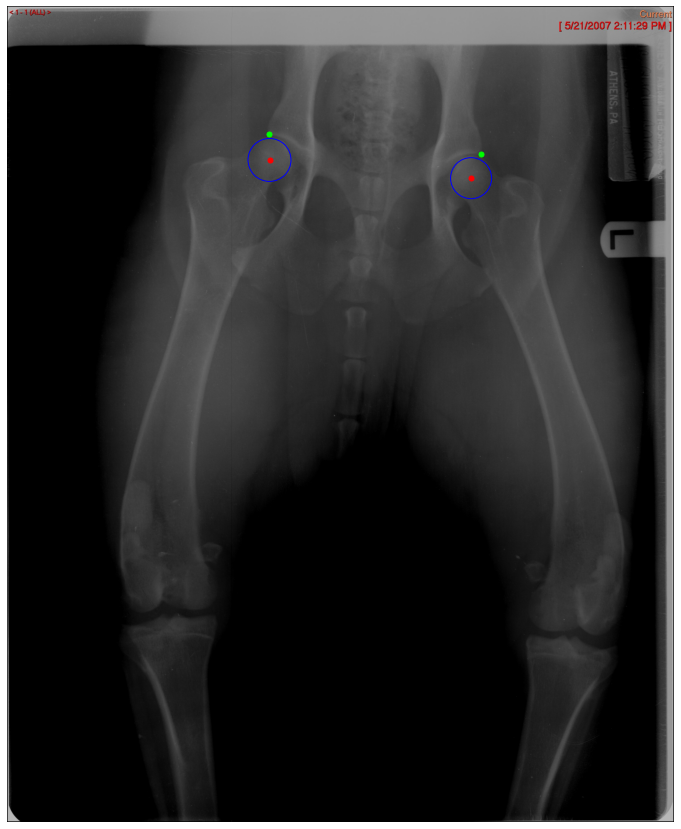

Processing /home/featurize/work/data/data/Valid/images/191789.jpg
center: [[[ 589  725]]

 [[1219  719]]]
head: [[[1229  637]]

 [[ 579  640]]]


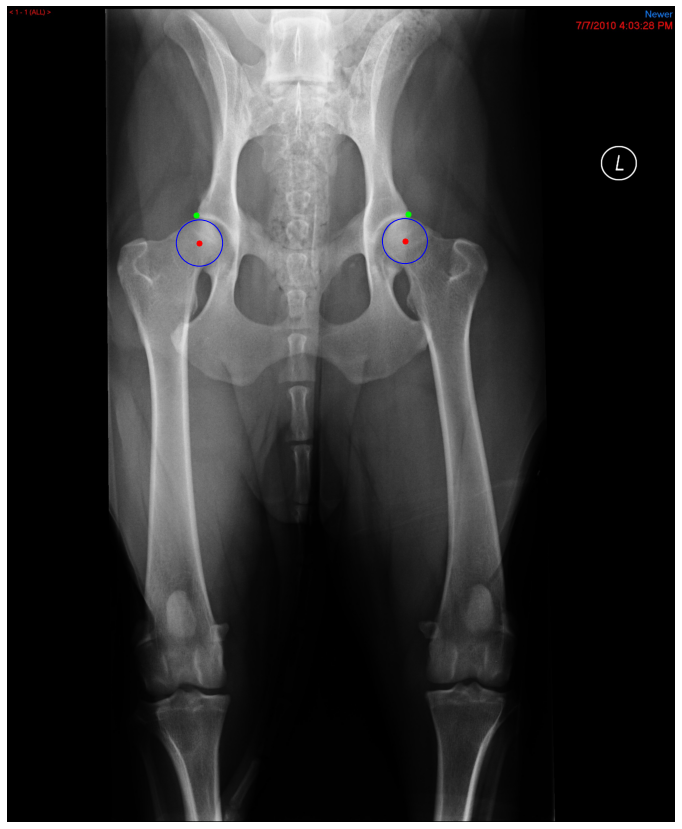

Processing /home/featurize/work/data/data/Valid/images/195849.jpg
center: [[[ 620  291]]

 [[1299  342]]]
head: [[[1287  259]]

 [[ 651  215]]

 [[1365  318]]]


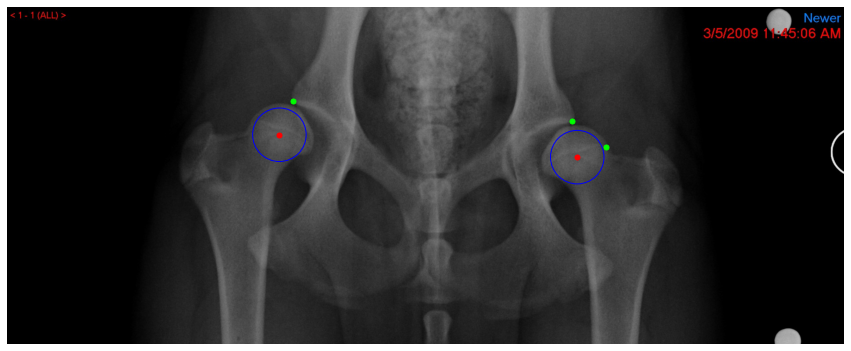

Processing /home/featurize/work/data/data/Valid/images/207341.jpg
head: [[[1298  258]]]


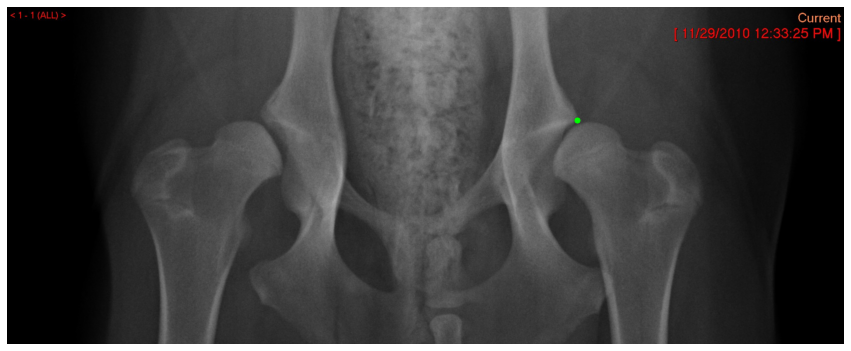

Processing /home/featurize/work/data/data/Valid/images/194495.jpg
center: [[[1394  363]]

 [[ 814  392]]]
head: [[[ 787  332]]

 [[1406  296]]]


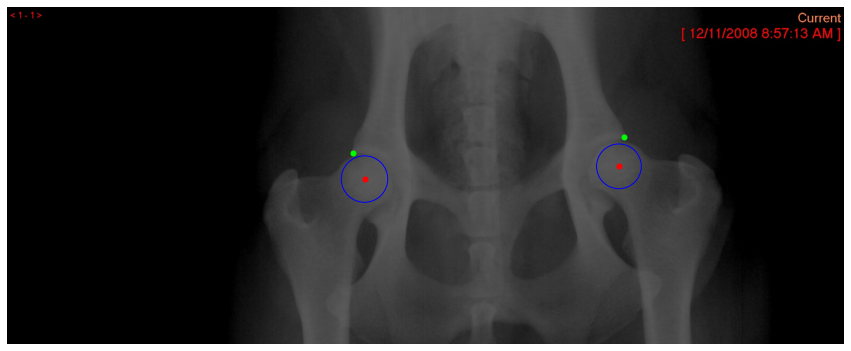

Processing /home/featurize/work/data/data/Valid/images/194955.jpg
head: [[[1459  343]]

 [[ 715  266]]]


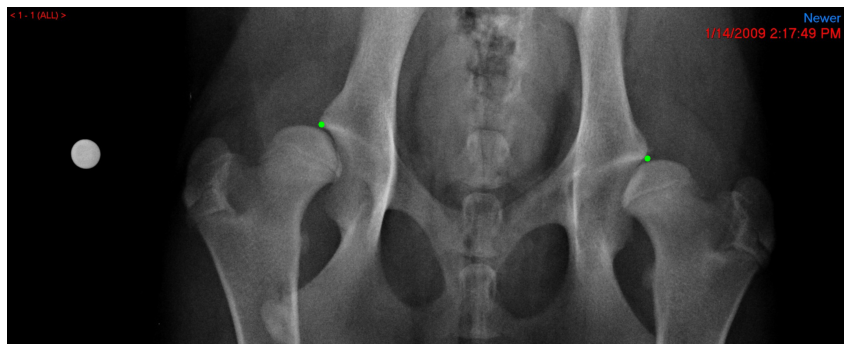

Processing /home/featurize/work/data/data/Valid/images/208763.jpg
center: [[[ 685  333]]

 [[1421  362]]]
head: [[[ 686  258]]

 [[1442  282]]]


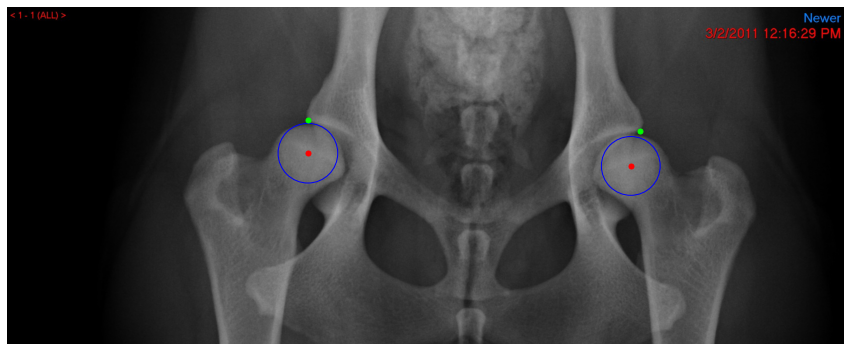

Processing /home/featurize/work/data/data/Valid/images/195827.jpg
center: [[[578 332]]]
head: [[[ 615  254]]

 [[1242  259]]

 [[1337  304]]]


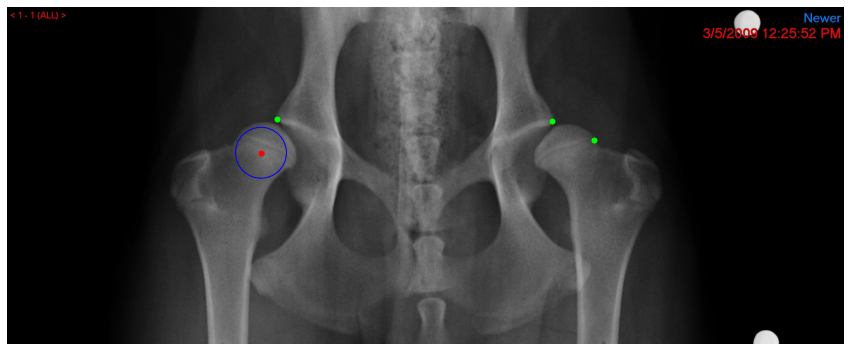

Processing /home/featurize/work/data/data/Valid/images/177424.jpg
head: [[[ 592  324]]

 [[1358  329]]]


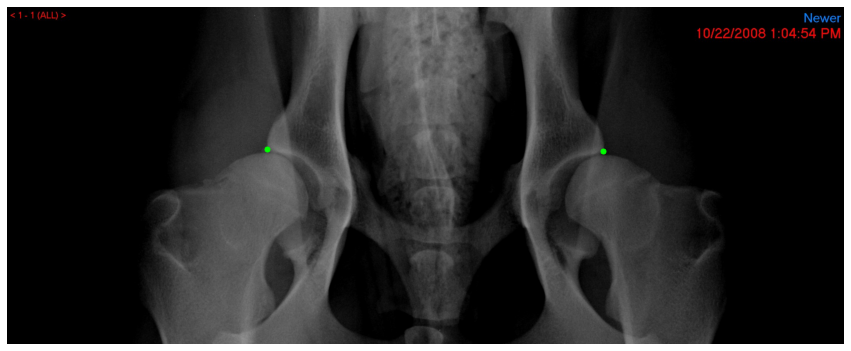

Processing /home/featurize/work/data/data/Valid/images/161797.jpg
center: [[[710 329]]]
head: [[[ 696  272]]

 [[1381  277]]]


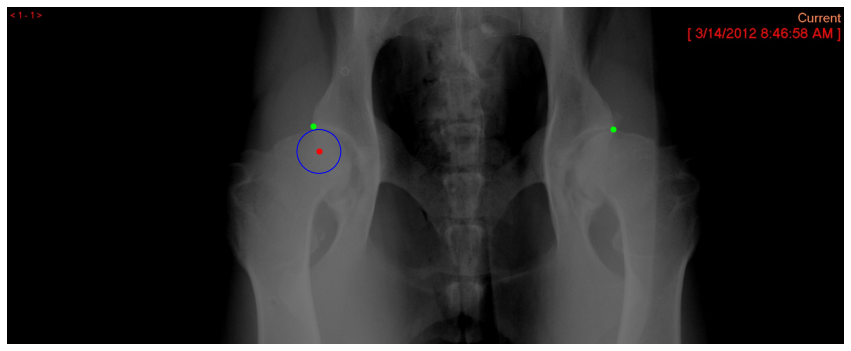

Processing /home/featurize/work/data/data/Valid/images/187156.jpg
center: [[[621 307]]]
head: [[[1425  326]]]


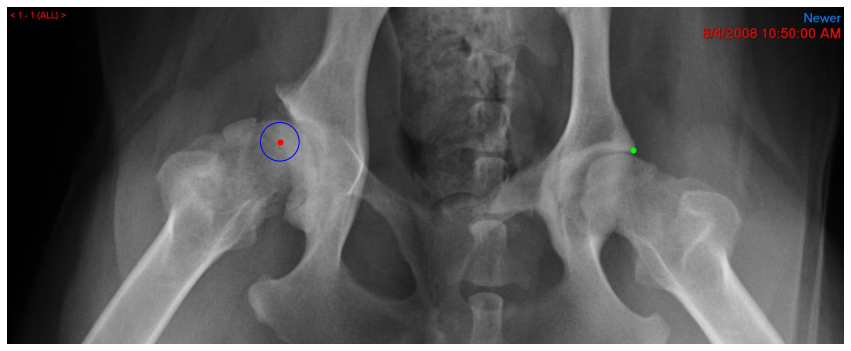

Processing /home/featurize/work/data/data/Valid/images/192237.jpg
center: [[[ 679  534]]

 [[1408  559]]]
head: [[[1389  468]]

 [[ 697  444]]]


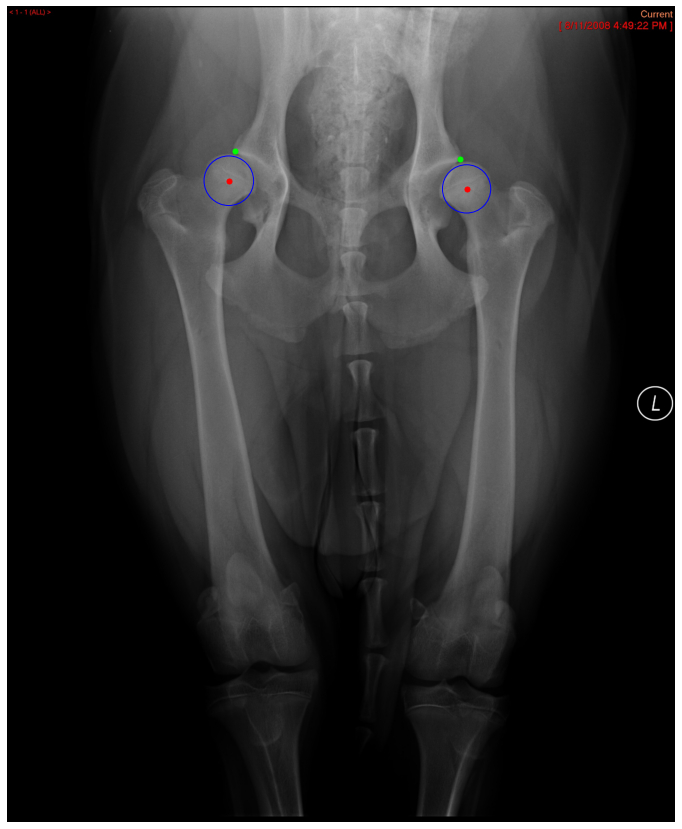

Processing /home/featurize/work/data/data/Valid/images/217378.jpg
center: [[[1107 1423]]

 [[2174 1508]]]
head: [[[2197 1356]]

 [[1113 1267]]]


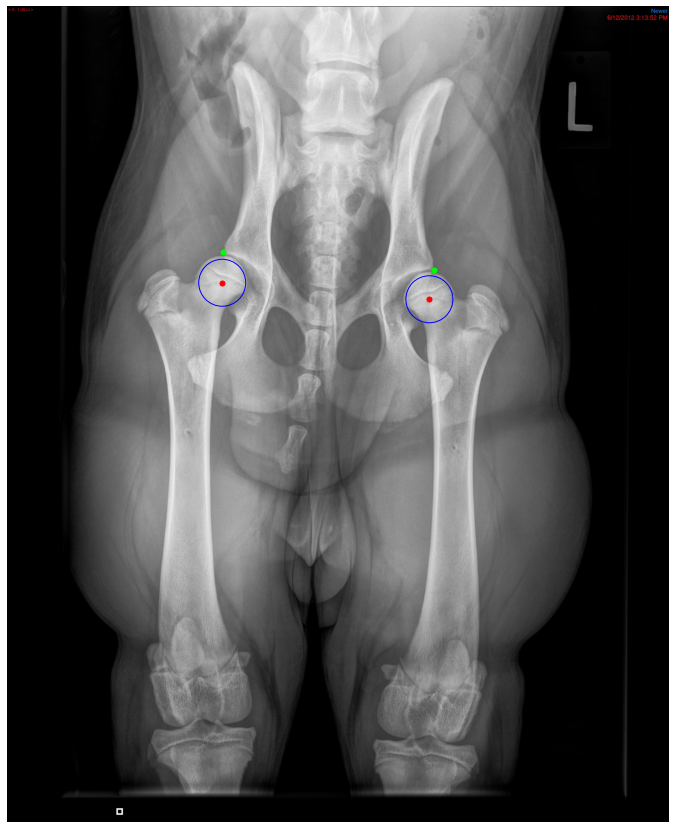

Processing /home/featurize/work/data/data/Valid/images/201697.jpg


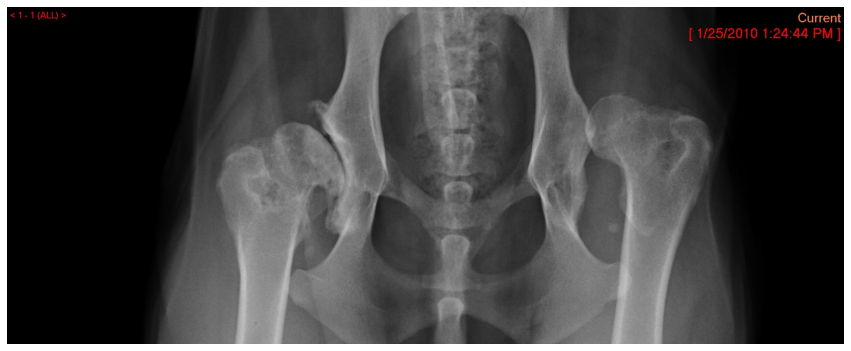

Processing /home/featurize/work/data/data/Valid/images/201935.jpg
center: [[[597 404]]]
head: [[[ 599  324]]

 [[1268  352]]]


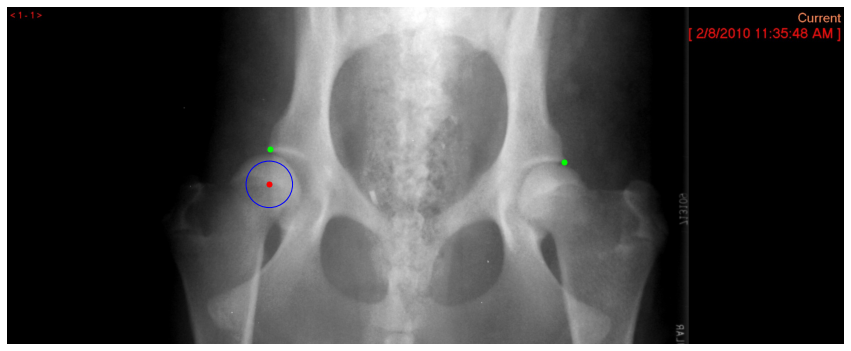

Processing /home/featurize/work/data/data/Valid/images/218026.jpg
center: [[[2188 1352]]

 [[1316 1386]]]
head: [[[1285 1268]]

 [[2211 1231]]]


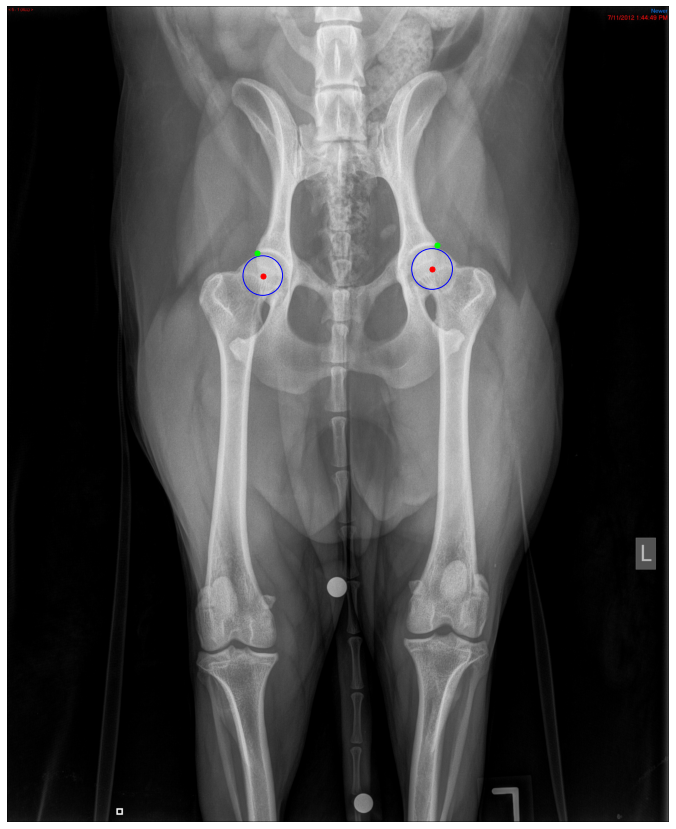

Processing /home/featurize/work/data/data/Valid/images/172118.jpg
center: [[[775 412]]]
head: [[[756 355]]]


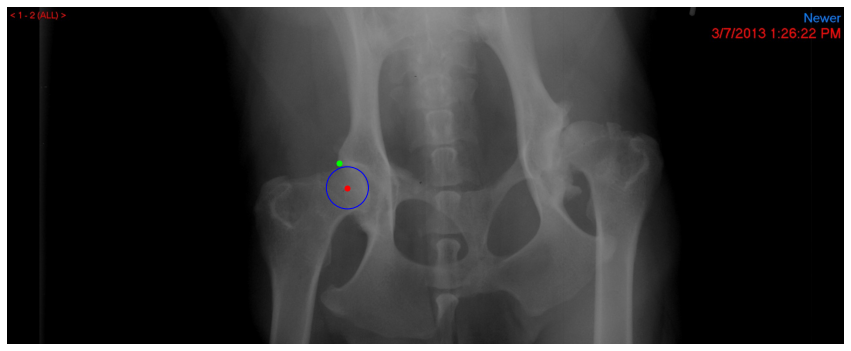

Processing /home/featurize/work/data/data/Valid/images/190237.jpg
center: [[[1340  359]]]
head: [[[1358  290]]]


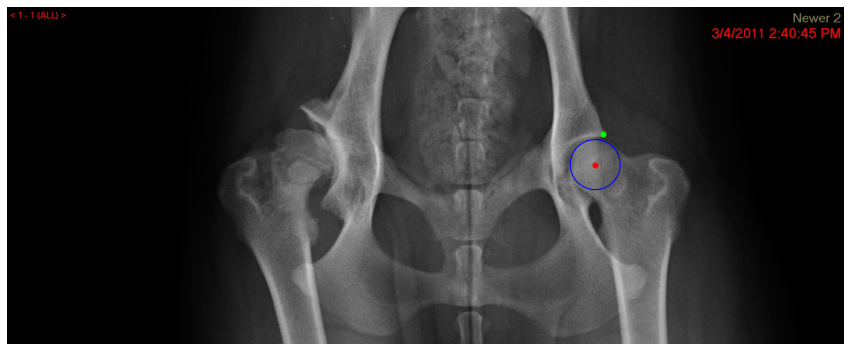

Processing /home/featurize/work/data/data/Valid/images/197232.jpg
center: [[[590 346]]]
head: [[[578 266]]]


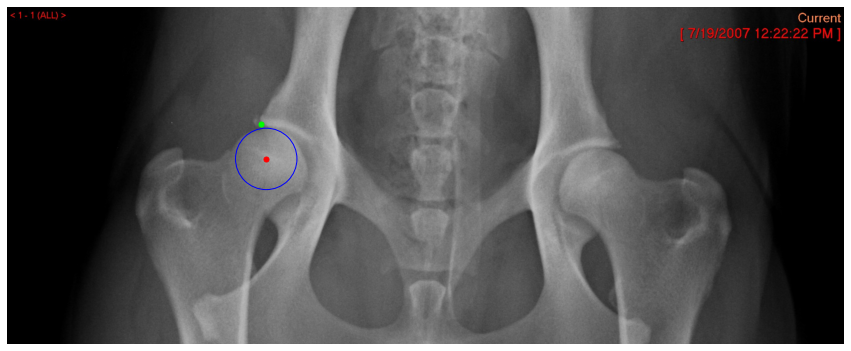

Processing /home/featurize/work/data/data/Valid/images/218690.jpg
center: [[[ 695  440]]

 [[1302  397]]]
head: [[[1295  325]]

 [[ 688  359]]]


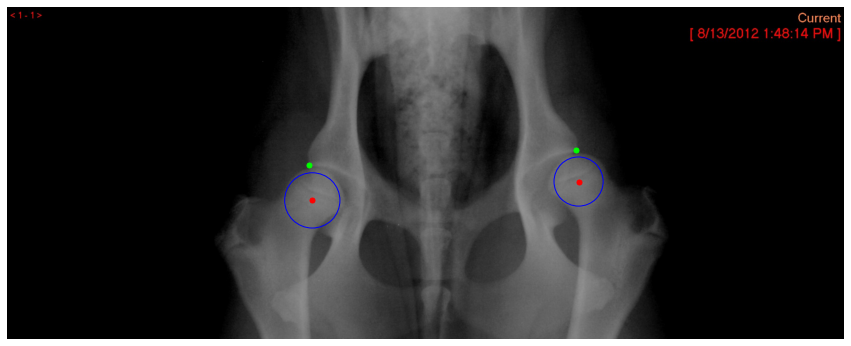

Processing /home/featurize/work/data/data/Valid/images/215195.jpg


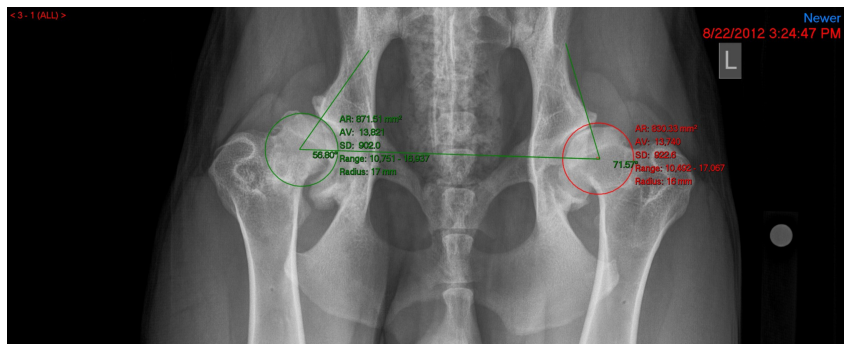

Processing /home/featurize/work/data/data/Valid/images/184896.jpg
center: [[[ 696 1213]]

 [[1285 1259]]]
head: [[[1288 1182]]

 [[ 710 1136]]]


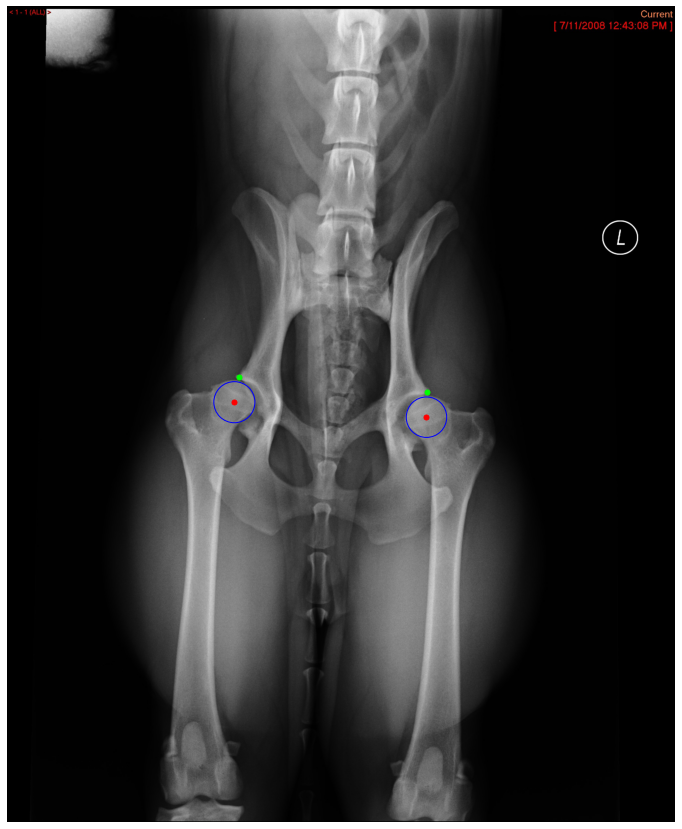

Processing /home/featurize/work/data/data/Valid/images/198301.jpg
center: [[[ 741  408]]

 [[1371  392]]]
head: [[[1383  322]]

 [[ 711  339]]]


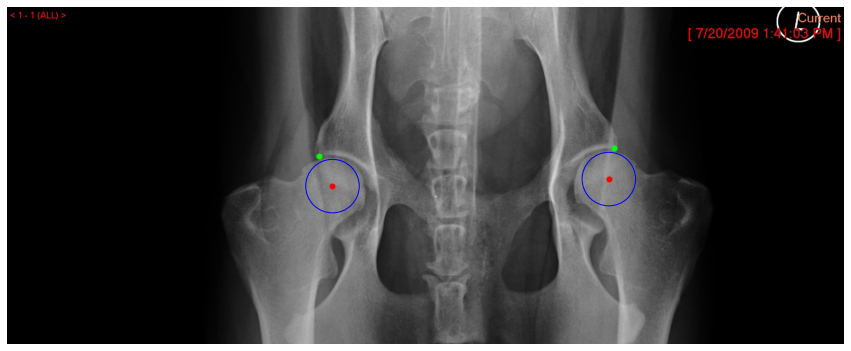

Processing /home/featurize/work/data/data/Valid/images/184956.jpg
center: [[[ 753  365]]

 [[1281  370]]]
head: [[[1290  305]]

 [[ 746  299]]]


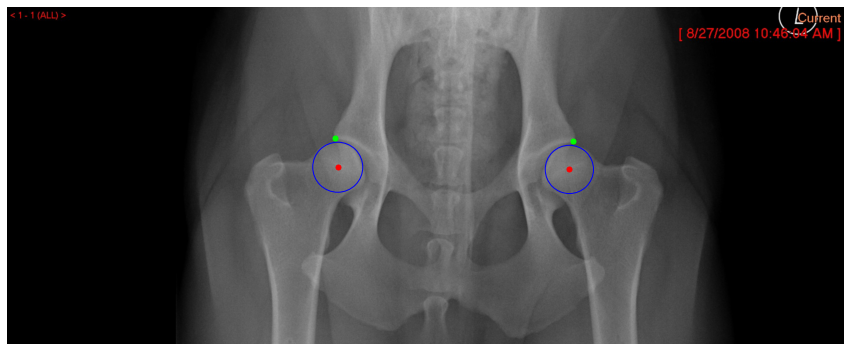

In [17]:
img_dir = '/home/featurize/work/data/data/Valid/images'
image_files = [f for f in os.listdir(img_dir) if f.lower().endswith(('.jpg', '.jpeg', '.png'))]

colors = [
    (255, 0, 0),    # 红色
    (0, 255, 0),    # 绿色
    (0, 0, 255),    # 蓝色
    (255, 255, 0),  # 黄色
]

for image_file in image_files:
    image_path = os.path.join(img_dir, image_file)
    print(f'Processing {image_path}')
    image = imread(image_path)
    
    init_default_scope(detector.cfg.get('default_scope', 'mmdet'))
    
    ## center
    detect_result_center = inference_detector(detector, image_path)
    
    CONF_THRES = 0.2

    pred_instance_center = detect_result_center.pred_instances.cpu().numpy()
    bboxes_center = np.concatenate((pred_instance_center.bboxes, pred_instance_center.scores[:, None]), axis=1)
    bboxes_center = bboxes_center[np.logical_and(pred_instance_center.labels == 0, pred_instance_center.scores > CONF_THRES)]
    bboxes_center = bboxes_center[nms(bboxes_center, 0.3)][:, :4].astype('int')
    
    if len(bboxes_center) > 0:
        pose_results_center = inference_topdown(pose_estimator, image_path, bboxes_center)
        
        try:
            data_samples_center = merge_data_samples(pose_results_center)
            center = data_samples_center.pred_instances.keypoints.astype('int')
            print(f'center: {center}')
        except ValueError as e:
            print(f'Error merging data samples: {e}')
            continue
                
    ## head   
    init_default_scope(detector.cfg.get('default_scope', 'mmdet'))
    detect_result_head = inference_detector(detector2, image_path)
    
    CONF_THRES = 0.5

    pred_instance_head = detect_result_head.pred_instances.cpu().numpy()
    bboxes_head = np.concatenate((pred_instance_head.bboxes, pred_instance_head.scores[:, None]), axis=1)
    bboxes_head = bboxes_head[np.logical_and(pred_instance_head.labels == 0, pred_instance_head.scores > CONF_THRES)]
    bboxes_head = bboxes_head[nms(bboxes_head, 0.3)][:, :4].astype('int')
    
    if len(bboxes_head) > 0:
        pose_results_head = inference_topdown(pose_estimator2, image_path, bboxes_head)
        
        try:
            data_samples_head = merge_data_samples(pose_results_head)
            head = data_samples_head.pred_instances.keypoints.astype('int')
            print(f'head: {head}')
        except ValueError as e:
            print(f'Error merging data samples: {e}')
            continue
        
    #####plot
    fig, ax = plt.subplots(figsize=(15, 15))  
    ax.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    ax.set_aspect('equal', 'box')

    # 绘制中心关键点和矩形框、圆圈
    if len(bboxes_center) > 0:
        for idx, bbox in enumerate(bboxes_center):
            keypoint = center[idx]
            #rect = patches.Rectangle((bbox[0], bbox[1]), bbox[2] - bbox[0], bbox[3] - bbox[1], linewidth=1, edgecolor='g', facecolor='none')
            #ax.add_patch(rect)
            
            
            # 绘制关键点
            
            for x, y in keypoint:
                center_x = x
                center_y = y
                radius = min(bbox[2] - bbox[0], bbox[3] - bbox[1]) // 2
                circle = plt.Circle((center_x, center_y), radius, color='b', fill=False)
                ax.add_patch(circle)
                ax.plot(x, y, 'o', color=np.array(colors[0])/255.0, markersize=5)

    # 绘制头部关键点
    if len(bboxes_head) > 0:
        for idx, bbox in enumerate(bboxes_head):
            keypoint = head[idx]
            for x, y in keypoint:
                ax.plot(x, y, 'o', color=np.array(colors[1])/255.0, markersize=5)
    
    plt.axis('off')
    plt.show()